# Explain ResNet50 on ImageNet multi-class output using SHAP Partition Explainer

This notebook demonstrates how to use SHAP for explaining models which do image classification. Here, we are explaining the output of ResNet50 model for classifying images into 1000 ImageNet classes. 

In [1]:
import json
import numpy as np
import shap
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from importlib import reload

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

### Loading Model and Data

In [2]:
# load pre-trained model and data
model = ResNet50(weights='imagenet')
X, y = shap.datasets.imagenet50()

In [3]:
# getting ImageNet 1000 class names
url = "https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json"
with open(shap.datasets.cache(url)) as file:
    class_names = [v[1] for v in json.load(file).values()]
#print("Number of ImageNet classes:", len(class_names))
#print("Class names:", class_names)

### SHAP ResNet50 model explanation for images 

Build a partition explainer with:
 - the model (a python function)
 - the masker (a python function)
 - the partition tree (a python function)
 - output names (a list of names of the output classes)

In [4]:
# python function to get model output; replace this function with your own model function. 
def f(x):
    tmp = x.copy()
    preprocess_input(tmp)
    return model(tmp)

In [5]:
# print(X[1])
yhat = f(X[1:2])
p = np.max(yhat)
i = np.argmax(yhat)
print(p)
print(i)
print(class_names[i])

0.6994136
132
American_egret


In [6]:
# define a masker that is used to mask out partitions of the input image. 
masker = shap.maskers.Image("blur(10, 10)", X[0].shape)

>> Enter masker._image.py: __init__
Input mask_value = blur(10, 10)
Input shape =  (224, 224, 3)
The masker will accept masks of shape =  (1, 150528)
     Why shape[0] = 1? --> 'we only return a single masked sample to average over'
     Shape[1] is just flattend input: 224x224x3 = 150528
Using OpenCV for masking
Created blue kernel from input:  (10, 10)

  >> Enter masker._image.py: build_partition_tree
    x_range = [0, 224],   y_range = [0, 224],   z_range = [0, 3]
      (Here x:height,  y:width,  z:channels)
    Create hierarchical clustering of size (150527, 4),
      where dim 0 is 224x3x224=(150527, 4)
      and dim 1 is 4 because each entry has:  [left child, right child, cost, subtree size]
    Init priority queue q
      Each entry:  [priority, xmin, xmax, ymin, ymax, zmin, zmax, parent idx, is left?]
    Current,  ('', 0, 224, 0, 224, 0, 3, -1, False)
    Left child (-75264, 0, 112, 0, 224, 0, 3, 150526, True)
    Right child: (-75264, 112, 224, 0, 224, 0, 3, 150526, False)


In [7]:
# create an explainer with model and image masker 
explainer = shap.Explainer(f, masker, output_names=class_names)

  >> Enter _explainer.py: __init__
Set masker using the blur masker we created
Algorithm assigned to type partition
   because 'issubclass(type(self.masker), maskers.Image`

  >> Enter _partition.py: __init__
  >> Enter _explainer.py: __init__
Set masker using the blur masker we created
  << Exit _explainer.py: __init__

    >> Enter _masked_model.py: make_masks:
    Cluster shape = (150527, 4)
    --> M = 150528
    Mask matrix length = '2 * M - 1' = 301055
    Howto convert indices: 'cluster_idx = mask_matrix_idx - M'
    << Exit _masked_model.py: make_masks: 

  << Exit _partition.py: __init__

  << Exit _explainer.py: __init__


>> Enter _eplainer.py: __call__
Num_rows = 1
Batch size = 50

  >> Enter _partition.py: __explain_row
  Input fixed context = auto
  Now fixed context = None
     But what is fixed context?

    >> Enter _masked_model.py: __init__
    (All we do here is set masker variables from args)
    This masker does not save what positions vary from the background
      (Which just prevents a computation-saving trick)
    Masker shape: ( 1 rows,  150528 cols )
    << Exit _masked_model.py: __init__

  >> Overloaded len() --> returns '_masker_cols' = 150528 <<  
  M = 150528
  Create (all false aka fully masked) mask of size (150528,) = [False False False ... False False False]

    >> Enter _masked_model.py: __call__
      >> Enter _masked_model.py: __full_masking_call
      Input masks shape: (1, 150528)

      [ Mask i = 0 ]
      ---------------
      Mask: [False False False ... False False False]
      Delta mask (mask OR last_mask): [False False False ... False False False]

        >> Ente

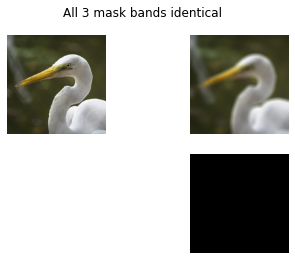

    << Exit _masked_model.py: __call__

  Used fully-masked mask to generate '_curr_base_value'
    (Model prediction where blur applied to all pixels)
    Base value shape = (1000,),  base value = [5.8717901652016735e-09, 2.339333882162009e-08, ...., 3.827721855031996e-07]
    (Why shape = {}? Equals the number of possible classes. Prediction is prob of each class)
    Prediction = 0.9643683433532715 (American_egret)
    (Larger blur --> degraded prediction

    >> Enter _masked_model.py: __call__
      >> Enter _masked_model.py: __full_masking_call
      Input masks shape: (1, 150528)

      [ Mask i = 0 ]
      ---------------
      Mask: [ True  True  True ...  True  True  True]
      Delta mask (mask OR last_mask): [ True  True  True ...  True  True  True]

        >> Enter masker/_image.py: __call__
        Before  blur: [117. 119. 116. ... 189. 196. 204.]
        Applied blur  (10, 10)  on image of shape (224, 224, 3).
        After   blur: [109.63 112.2  110.02 ... 187.07 193.9

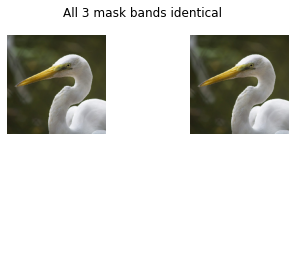

    << Exit _masked_model.py: __call__

   Used fully-unmasked mask to generate 'f11'
     (Model prediction with no blurring
     Prediction = 0.6994135975837708 (American_egret)
     (Exact same prediction as using trained model
  Selecting top {} predictions with 'argsort.flip[:5]' on output f11:
    Explanation values = [132 134 131 130  84]
    (American_egret, crane, ..., little_blue_heron)
  Calculated shape of SHAP output values = (301055, 5)
    ('2*self._clustering.shape[0]+1, len(outputs)')

    >> Enter _partition.py: owen
  >> Overloaded len() --> returns '_masker_cols' = 150528 <<  
    
Creating batch
    evals = 0
    q: ind = 301054 (-> 150526)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 1.0
       cluster row = [301053. 301052.      0. 150528.]
    Is leaf? = False


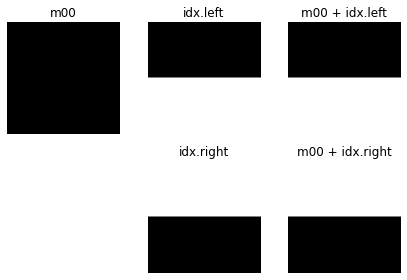

    Created batch of 2 masks

    >> Enter _masked_model.py: __call__
      >> Enter _masked_model.py: __full_masking_call
      Input masks shape: (2, 150528)

      [ Mask i = 0 ]
      ---------------
      Mask: [False False False ...  True  True  True]
      Delta mask (mask OR last_mask): [False False False ...  True  True  True]

        >> Enter masker/_image.py: __call__
        Before  blur: [117. 119. 116. ... 189. 196. 204.]
        Applied blur  (10, 10)  on image of shape (224, 224, 3).
        After   blur: [109.63 112.2  110.02 ... 187.07 193.95 201.79]
        Replace masked values with blurred values
        Mask: [False False False ...  True  True  True]
        Output image: [109.63 112.2  110.02 ... 189.   196.   204.  ]
        << Exit masker/_image.py: __call__

      Number of masked inputs = 1
      (Update) num_mask_samples = [1 0]
      (Update) num_varying_rows = [1 0]
      (Update) self.variants = None
      (Update) batch_positions = [0 1 0]
      Adding 

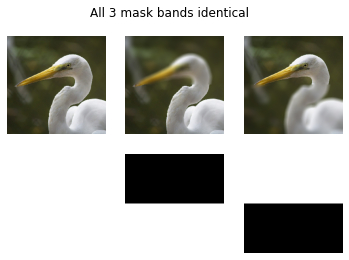

    << Exit _masked_model.py: __call__

    Ran the batch -> evaluated model on each masked input
    Using results of batch to add new nodes:
      i = 0
      weight = 1.0,  new weight = 0.5


    
Creating batch
    evals = 2
    q: ind = 301052 (-> 150524)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       weight = 0.5
       cluster row = [301049. 301048.      0.  75264.]
    Is leaf? = False


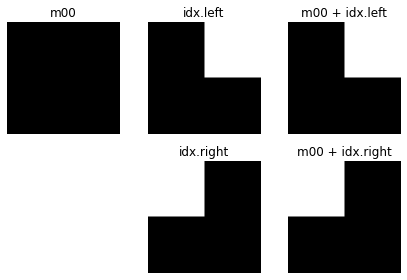

    
Creating batch
    evals = 2
    q: ind = 301052 (-> 150524)
       m00 = [False False False ...  True  True  True]
       f00 = [9.97675121e-01 1.33836968e-03 2.61316454e-04 4.99487738e-04
 7.17300509e-06]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.5
       cluster row = [301049. 301048.      0.  75264.]
    Is leaf? = False


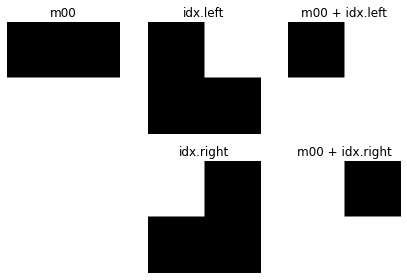

    
Creating batch
    evals = 2
    q: ind = 301053 (-> 150525)
       m00 = [ True  True  True ... False False False]
       f00 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.5
       cluster row = [301051. 301050.      0.  75264.]
    Is leaf? = False


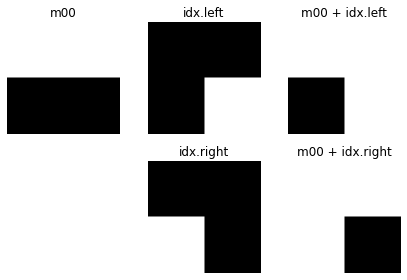

    
Creating batch
    evals = 2
    q: ind = 301053 (-> 150525)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [9.97675121e-01 1.33836968e-03 2.61316454e-04 4.99487738e-04
 7.17300509e-06]
       weight = 0.5
       cluster row = [301051. 301050.      0.  75264.]
    Is leaf? = False


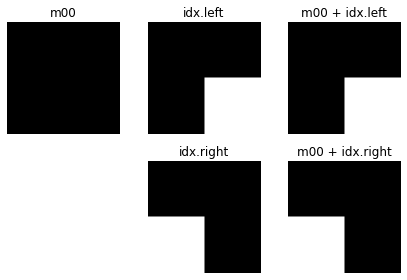

    Created batch of 8 masks

    >> Enter _masked_model.py: __call__
      >> Enter _masked_model.py: __full_masking_call
      Input masks shape: (8, 150528)

      [ Mask i = 0 ]
      ---------------
      Mask: [False False False ... False False False]
      Delta mask (mask OR last_mask): [False False False ... False False False]

        >> Enter masker/_image.py: __call__
        Before  blur: [117. 119. 116. ... 189. 196. 204.]
        Applied blur  (10, 10)  on image of shape (224, 224, 3).
        After   blur: [109.63 112.2  110.02 ... 187.07 193.95 201.79]
        Replace masked values with blurred values
        Mask: [False False False ... False False False]
        Output image: [109.63 112.2  110.02 ... 187.07 193.95 201.79]
        << Exit masker/_image.py: __call__

      Number of masked inputs = 1
      (Update) num_mask_samples = [1 0 0 0 0 0 0 0]
      (Update) num_varying_rows = [1 0 0 0 0 0 0 0]
      (Update) self.variants = None
      (Update) batch_positions

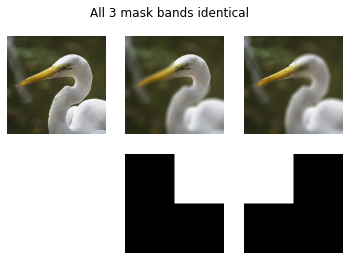

    << Exit _masked_model.py: __call__

    Ran the batch -> evaluated model on each masked input
    Using results of batch to add new nodes:
      i = 0
      weight = 0.5,  new weight = 0.25


      i = 1
      weight = 0.5,  new weight = 0.25


      i = 2
      weight = 0.5,  new weight = 0.25


      i = 3
      weight = 0.5,  new weight = 0.25


    
Creating batch
    evals = 10
    q: ind = 301049 (-> 150521)
       m00 = [ True  True  True ... False False False]
       f00 = [9.88559663e-01 8.44429992e-03 1.27640227e-03 3.82139988e-04
 4.20199503e-05]
       f11 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       weight = 0.25
       cluster row = [301043. 301041.      0.  37632.]
    Is leaf? = False


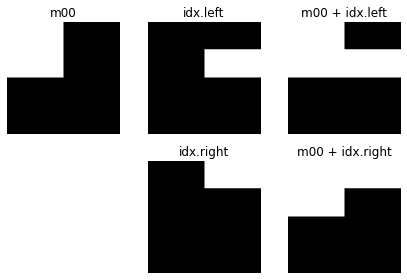

    
Creating batch
    evals = 10
    q: ind = 301049 (-> 150521)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [9.95763898e-01 2.63077253e-03 1.23204745e-03 1.16996453e-04
 7.92879728e-05]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.25
       cluster row = [301043. 301041.      0.  37632.]
    Is leaf? = False


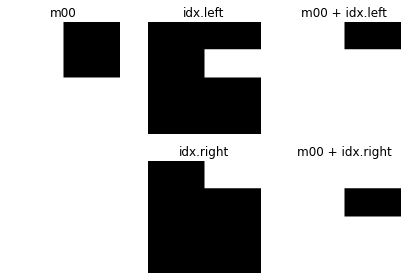

    
Creating batch
    evals = 10
    q: ind = 301049 (-> 150521)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [0.73222899 0.08632725 0.13955829 0.02814021 0.00088052]
       weight = 0.25
       cluster row = [301043. 301041.      0.  37632.]
    Is leaf? = False


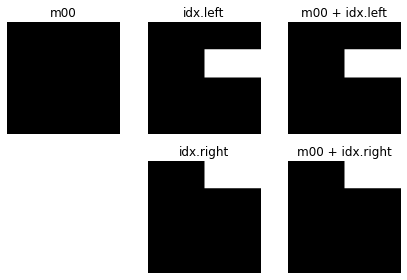

    
Creating batch
    evals = 10
    q: ind = 301049 (-> 150521)
       m00 = [False False False ...  True  True  True]
       f00 = [9.97675121e-01 1.33836968e-03 2.61316454e-04 4.99487738e-04
 7.17300509e-06]
       f11 = [0.79916835 0.08556692 0.09424531 0.00855549 0.0032018 ]
       weight = 0.25
       cluster row = [301043. 301041.      0.  37632.]
    Is leaf? = False


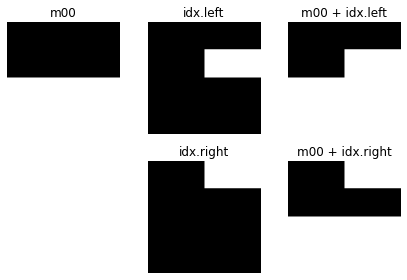

    
Creating batch
    evals = 10
    q: ind = 301051 (-> 150523)
       m00 = [ True  True  True ... False False False]
       f00 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       f11 = [7.91631281e-01 1.35545582e-01 6.56930655e-02 4.62190108e-03
 3.72192299e-04]
       weight = 0.25
       cluster row = [301047. 301045.      0.  37632.]
    Is leaf? = False


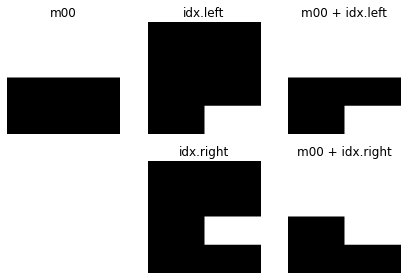

    
Creating batch
    evals = 10
    q: ind = 301048 (-> 150520)
       m00 = [False False False ... False False False]
       f00 = [0.73222899 0.08632725 0.13955829 0.02814021 0.00088052]
       f11 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       weight = 0.25
       cluster row = [301042. 301040.      0.  37632.]
    Is leaf? = False


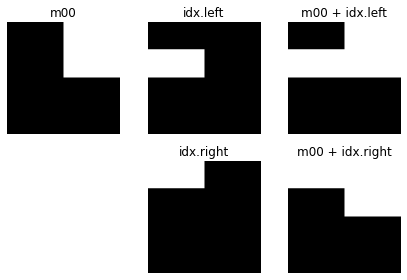

    
Creating batch
    evals = 10
    q: ind = 301048 (-> 150520)
       m00 = [False False False ...  True  True  True]
       f00 = [0.79916835 0.08556692 0.09424531 0.00855549 0.0032018 ]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.25
       cluster row = [301042. 301040.      0.  37632.]
    Is leaf? = False


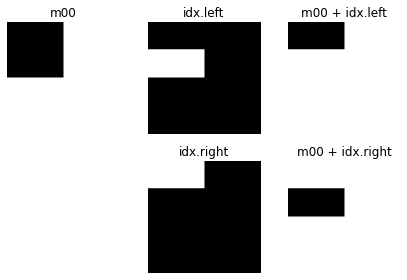

    
Creating batch
    evals = 10
    q: ind = 301050 (-> 150522)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [7.91631281e-01 1.35545582e-01 6.56930655e-02 4.62190108e-03
 3.72192299e-04]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.25
       cluster row = [301046. 301044.      0.  37632.]
    Is leaf? = False


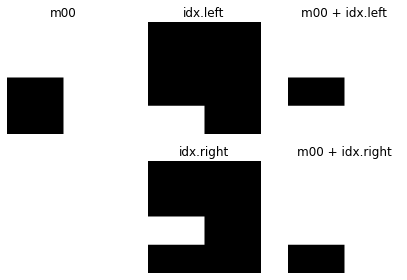

    
Creating batch
    evals = 10
    q: ind = 301051 (-> 150523)
       m00 = [ True  True  True ... False False False]
       f00 = [6.51186824e-01 2.31243774e-01 1.12901889e-01 3.41449887e-03
 2.84374080e-04]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.25
       cluster row = [301047. 301045.      0.  37632.]
    Is leaf? = False


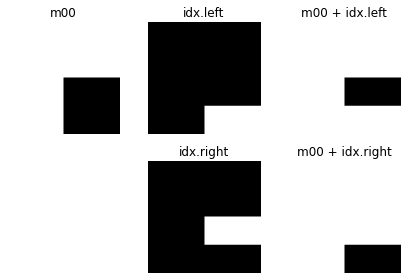

    
Creating batch
    evals = 10
    q: ind = 301051 (-> 150523)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [9.98404324e-01 5.42364200e-04 5.08525154e-05 7.62433978e-04
 6.13597308e-07]
       weight = 0.25
       cluster row = [301047. 301045.      0.  37632.]
    Is leaf? = False


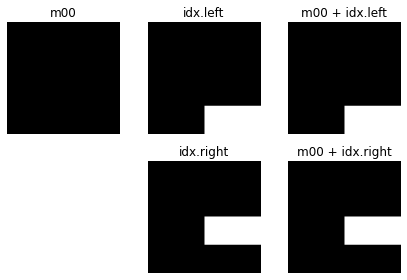

    
Creating batch
    evals = 10
    q: ind = 301050 (-> 150522)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [9.92856503e-01 3.77783156e-03 2.69761542e-04 1.13715068e-03
 2.55263476e-05]
       weight = 0.25
       cluster row = [301046. 301044.      0.  37632.]
    Is leaf? = False


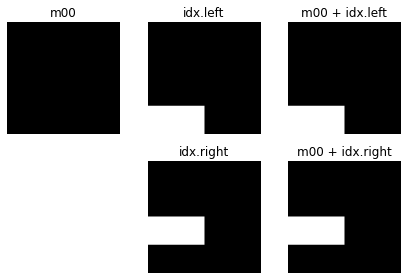

    
Creating batch
    evals = 10
    q: ind = 301048 (-> 150520)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [9.88559663e-01 8.44429992e-03 1.27640227e-03 3.82139988e-04
 4.20199503e-05]
       weight = 0.25
       cluster row = [301042. 301040.      0.  37632.]
    Is leaf? = False


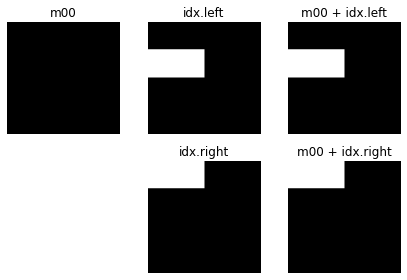

    
Creating batch
    evals = 10
    q: ind = 301050 (-> 150522)
       m00 = [ True  True  True ... False False False]
       f00 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       f11 = [6.51186824e-01 2.31243774e-01 1.12901889e-01 3.41449887e-03
 2.84374080e-04]
       weight = 0.25
       cluster row = [301046. 301044.      0.  37632.]
    Is leaf? = False


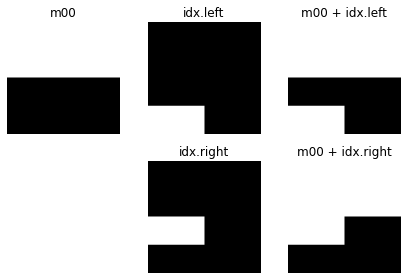

    
Creating batch
    evals = 10
    q: ind = 301051 (-> 150523)
       m00 = [False False False ... False False False]
       f00 = [9.92856503e-01 3.77783156e-03 2.69761542e-04 1.13715068e-03
 2.55263476e-05]
       f11 = [9.97675121e-01 1.33836968e-03 2.61316454e-04 4.99487738e-04
 7.17300509e-06]
       weight = 0.25
       cluster row = [301047. 301045.      0.  37632.]
    Is leaf? = False


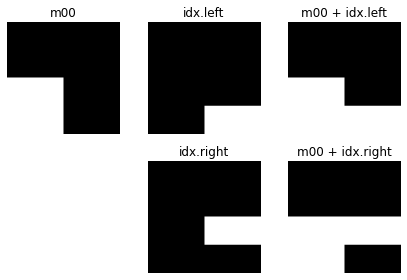

    
Creating batch
    evals = 10
    q: ind = 301048 (-> 150520)
       m00 = [False False False ...  True  True  True]
       f00 = [9.97675121e-01 1.33836968e-03 2.61316454e-04 4.99487738e-04
 7.17300509e-06]
       f11 = [9.95763898e-01 2.63077253e-03 1.23204745e-03 1.16996453e-04
 7.92879728e-05]
       weight = 0.25
       cluster row = [301042. 301040.      0.  37632.]
    Is leaf? = False


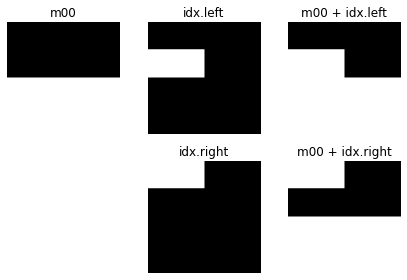

    
Creating batch
    evals = 10
    q: ind = 301050 (-> 150522)
       m00 = [False False False ...  True  True  True]
       f00 = [9.98404324e-01 5.42364200e-04 5.08525154e-05 7.62433978e-04
 6.13597308e-07]
       f11 = [9.97675121e-01 1.33836968e-03 2.61316454e-04 4.99487738e-04
 7.17300509e-06]
       weight = 0.25
       cluster row = [301046. 301044.      0.  37632.]
    Is leaf? = False


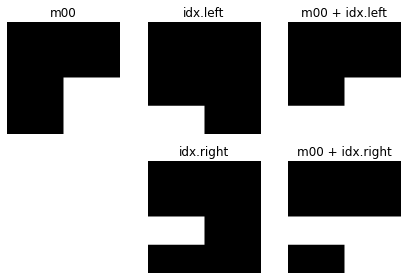

    Created batch of 32 masks

    >> Enter _masked_model.py: __call__
      >> Enter _masked_model.py: __full_masking_call
      Input masks shape: (32, 150528)

      [ Mask i = 0 ]
      ---------------
      Mask: [ True  True  True ... False False False]
      Delta mask (mask OR last_mask): [ True  True  True ... False False False]

        >> Enter masker/_image.py: __call__
        Before  blur: [117. 119. 116. ... 189. 196. 204.]
        Applied blur  (10, 10)  on image of shape (224, 224, 3).
        After   blur: [109.63 112.2  110.02 ... 187.07 193.95 201.79]
        Replace masked values with blurred values
        Mask: [ True  True  True ... False False False]
        Output image: [117.   119.   116.   ... 187.07 193.95 201.79]
        << Exit masker/_image.py: __call__

      Number of masked inputs = 1
      (Update) num_mask_samples = [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
      (Update) num_varying_rows = [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

      Sending all to model for set of predictions:   outputs = model(joined_masked_inputs)
          (32 masks,  1000 classes ====> outputs.shape = (32, 1000))
      Returning (32, 1000) averaged output
      << Exit _masked_model.py: __full_masking_call


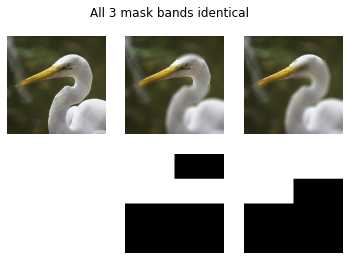

    << Exit _masked_model.py: __call__



  0%|          | 0/48 [00:00<?, ?it/s]

    Ran the batch -> evaluated model on each masked input
    Using results of batch to add new nodes:
      i = 0
      weight = 0.25,  new weight = 0.125


      i = 1
      weight = 0.25,  new weight = 0.125


      i = 2
      weight = 0.25,  new weight = 0.125


      i = 3
      weight = 0.25,  new weight = 0.125


      i = 4
      weight = 0.25,  new weight = 0.125


      i = 5
      weight = 0.25,  new weight = 0.125


      i = 6
      weight = 0.25,  new weight = 0.125


      i = 7
      weight = 0.25,  new weight = 0.125


      i = 8
      weight = 0.25,  new weight = 0.125


      i = 9
      weight = 0.25,  new weight = 0.125


      i = 10
      weight = 0.25,  new weight = 0.125


      i = 11
      weight = 0.25,  new weight = 0.125


      i = 12
      weight = 0.25,  new weight = 0.125


      i = 13
      weight = 0.25,  new weight = 0.125


      i = 14
      weight = 0.25,  new weight = 0.125


      i = 15
      weight = 0.25,  new weight = 0.125


    
Creati

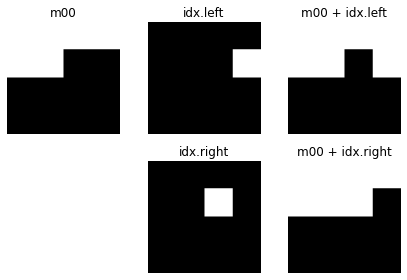

    
Creating batch
    evals = 42
    q: ind = 301043 (-> 150515)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [9.92939711e-01 4.82164090e-03 1.59236358e-03 3.64906213e-04
 7.65649020e-05]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.125
       cluster row = [301031. 301030.      0.  18816.]
    Is leaf? = False


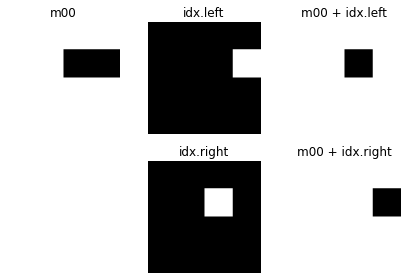

    
Creating batch
    evals = 42
    q: ind = 301043 (-> 150515)
       m00 = [False False False ... False False False]
       f00 = [9.86945450e-01 5.02923178e-03 1.64362064e-04 2.60613975e-03
 6.59943362e-06]
       f11 = [0.73222899 0.08632725 0.13955829 0.02814021 0.00088052]
       weight = 0.125
       cluster row = [301031. 301030.      0.  18816.]
    Is leaf? = False


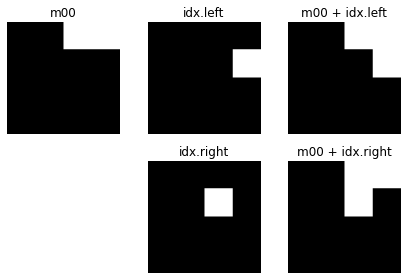

    
Creating batch
    evals = 42
    q: ind = 301043 (-> 150515)
       m00 = [False False False ...  True  True  True]
       f00 = [9.97216105e-01 1.45695498e-03 1.46819933e-04 9.15933691e-04
 1.12566177e-05]
       f11 = [0.79916835 0.08556692 0.09424531 0.00855549 0.0032018 ]
       weight = 0.125
       cluster row = [301031. 301030.      0.  18816.]
    Is leaf? = False


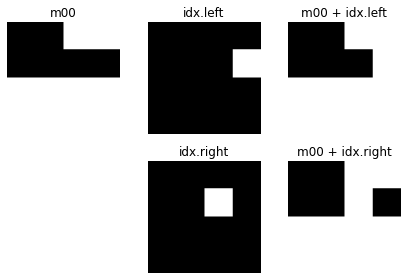

    
Creating batch
    evals = 42
    q: ind = 301041 (-> 150513)
       m00 = [ True  True  True ... False False False]
       f00 = [8.33285213e-01 9.13486555e-02 7.30857551e-02 1.12009305e-03
 1.42883364e-04]
       f11 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       weight = 0.125
       cluster row = [301027. 301026.      0.  18816.]
    Is leaf? = False


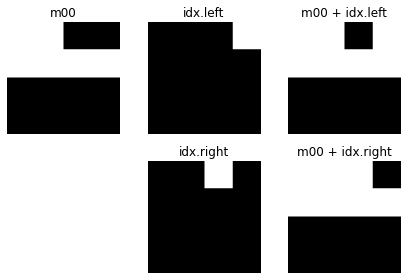

    
Creating batch
    evals = 42
    q: ind = 301043 (-> 150515)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [9.95763898e-01 2.63077253e-03 1.23204745e-03 1.16996453e-04
 7.92879728e-05]
       f11 = [8.26953471e-01 9.05601829e-02 7.78028667e-02 1.49580417e-03
 6.79996214e-04]
       weight = 0.125
       cluster row = [301031. 301030.      0.  18816.]
    Is leaf? = False


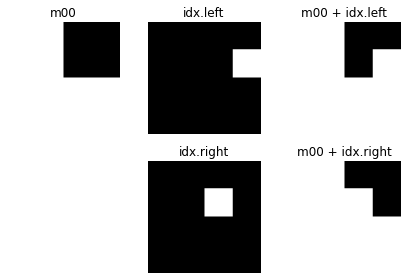

    
Creating batch
    evals = 42
    q: ind = 301047 (-> 150519)
       m00 = [ True  True  True ... False False False]
       f00 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       f11 = [8.04756522e-01 1.26974329e-01 6.30463213e-02 3.66568915e-03
 2.13801963e-04]
       weight = 0.125
       cluster row = [301039. 301038.      0.  18816.]
    Is leaf? = False


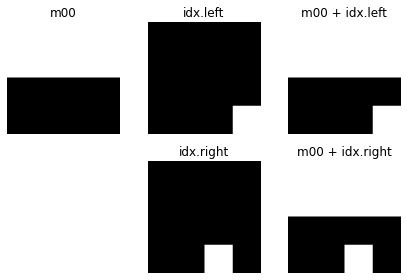

    
Creating batch
    evals = 42
    q: ind = 301043 (-> 150515)
       m00 = [ True  True  True ... False False False]
       f00 = [9.88559663e-01 8.44429992e-03 1.27640227e-03 3.82139988e-04
 4.20199503e-05]
       f11 = [8.33285213e-01 9.13486555e-02 7.30857551e-02 1.12009305e-03
 1.42883364e-04]
       weight = 0.125
       cluster row = [301031. 301030.      0.  18816.]
    Is leaf? = False


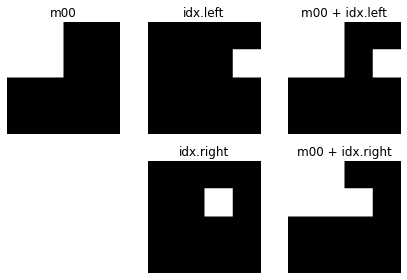

    
Creating batch
    evals = 42
    q: ind = 301041 (-> 150513)
       m00 = [False False False ... False False False]
       f00 = [8.79301369e-01 4.04670760e-02 6.70879036e-02 6.13572076e-03
 3.84729094e-04]
       f11 = [0.73222899 0.08632725 0.13955829 0.02814021 0.00088052]
       weight = 0.125
       cluster row = [301027. 301026.      0.  18816.]
    Is leaf? = False


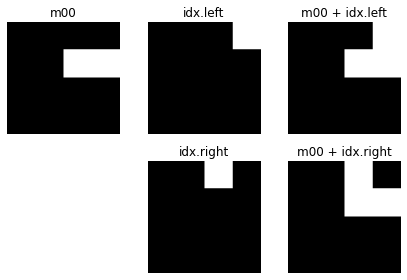

    
Creating batch
    evals = 42
    q: ind = 301041 (-> 150513)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [8.26953471e-01 9.05601829e-02 7.78028667e-02 1.49580417e-03
 6.79996214e-04]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.125
       cluster row = [301027. 301026.      0.  18816.]
    Is leaf? = False


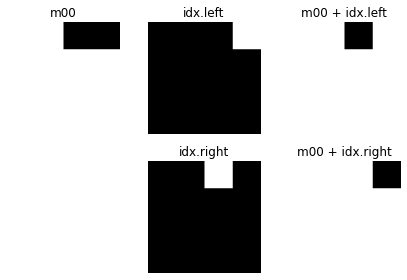

    
Creating batch
    evals = 42
    q: ind = 301043 (-> 150515)
       m00 = [False False False ...  True  True  True]
       f00 = [9.97675121e-01 1.33836968e-03 2.61316454e-04 4.99487738e-04
 7.17300509e-06]
       f11 = [0.87994462 0.05604152 0.05410219 0.00266077 0.001779  ]
       weight = 0.125
       cluster row = [301031. 301030.      0.  18816.]
    Is leaf? = False


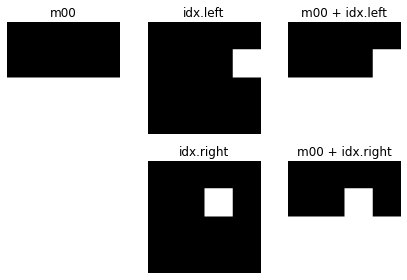

    
Creating batch
    evals = 42
    q: ind = 301042 (-> 150514)
       m00 = [ True  True  True ... False False False]
       f00 = [0.72956687 0.10471309 0.11544427 0.03731802 0.00138425]
       f11 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       weight = 0.125
       cluster row = [301029. 301028.      0.  18816.]
    Is leaf? = False


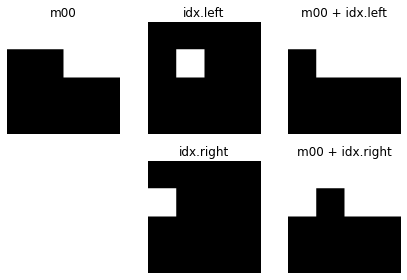

    
Creating batch
    evals = 42
    q: ind = 301046 (-> 150518)
       m00 = [ True  True  True ... False False False]
       f00 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       f11 = [7.59663224e-01 1.75118044e-01 6.14721030e-02 2.71094707e-03
 1.61386546e-04]
       weight = 0.125
       cluster row = [301037. 301036.      0.  18816.]
    Is leaf? = False


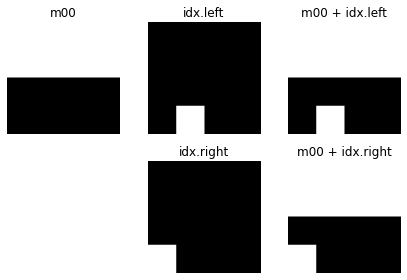

    
Creating batch
    evals = 42
    q: ind = 301044 (-> 150516)
       m00 = [ True  True  True ... False False False]
       f00 = [7.59663224e-01 1.75118044e-01 6.14721030e-02 2.71094707e-03
 1.61386546e-04]
       f11 = [6.51186824e-01 2.31243774e-01 1.12901889e-01 3.41449887e-03
 2.84374080e-04]
       weight = 0.125
       cluster row = [301033. 301032.      0.  18816.]
    Is leaf? = False


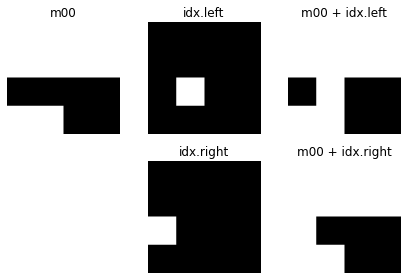

    
Creating batch
    evals = 42
    q: ind = 301042 (-> 150514)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [0.79497772 0.0991587  0.08245772 0.01049735 0.00382019]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.125
       cluster row = [301029. 301028.      0.  18816.]
    Is leaf? = False


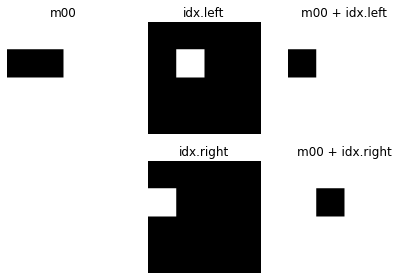

    
Creating batch
    evals = 42
    q: ind = 301043 (-> 150515)
       m00 = [False False False ... False False False]
       f00 = [9.64368343e-01 6.24777749e-03 6.09428564e-04 3.24184843e-03
 1.13633323e-05]
       f11 = [8.79301369e-01 4.04670760e-02 6.70879036e-02 6.13572076e-03
 3.84729094e-04]
       weight = 0.125
       cluster row = [301031. 301030.      0.  18816.]
    Is leaf? = False


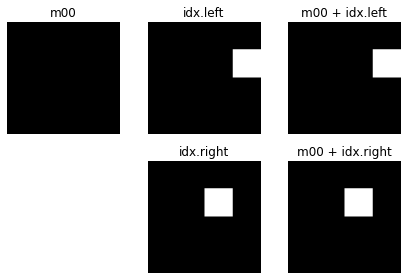

    
Creating batch
    evals = 42
    q: ind = 301042 (-> 150514)
       m00 = [False False False ... False False False]
       f00 = [0.73222899 0.08632725 0.13955829 0.02814021 0.00088052]
       f11 = [6.83792770e-01 1.70320541e-01 1.41457722e-01 3.06593627e-03
 1.20065670e-04]
       weight = 0.125
       cluster row = [301029. 301028.      0.  18816.]
    Is leaf? = False


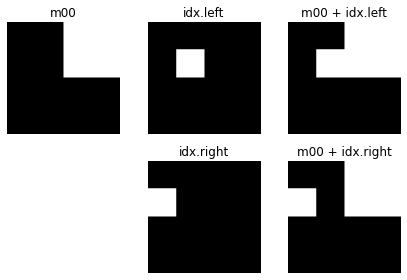

    
Creating batch
    evals = 42
    q: ind = 301047 (-> 150519)
       m00 = [ True  True  True ... False False False]
       f00 = [7.08501518e-01 2.07187027e-01 7.44144619e-02 5.98882884e-03
 4.97466477e-04]
       f11 = [7.91631281e-01 1.35545582e-01 6.56930655e-02 4.62190108e-03
 3.72192299e-04]
       weight = 0.125
       cluster row = [301039. 301038.      0.  18816.]
    Is leaf? = False


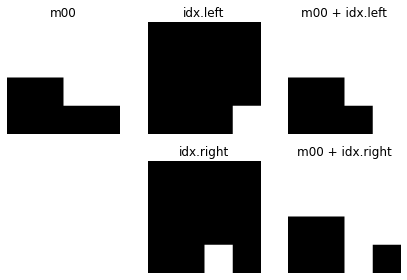

    
Creating batch
    evals = 42
    q: ind = 301042 (-> 150514)
       m00 = [False False False ...  True  True  True]
       f00 = [0.79916835 0.08556692 0.09424531 0.00855549 0.0032018 ]
       f11 = [7.16154397e-01 1.48520112e-01 1.29146442e-01 2.77174800e-03
 6.17106678e-04]
       weight = 0.125
       cluster row = [301029. 301028.      0.  18816.]
    Is leaf? = False


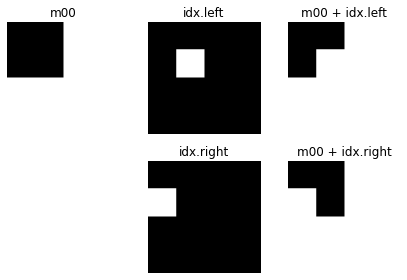

    
Creating batch
    evals = 42
    q: ind = 301041 (-> 150513)
       m00 = [False False False ...  True  True  True]
       f00 = [0.87994462 0.05604152 0.05410219 0.00266077 0.001779  ]
       f11 = [0.79916835 0.08556692 0.09424531 0.00855549 0.0032018 ]
       weight = 0.125
       cluster row = [301027. 301026.      0.  18816.]
    Is leaf? = False


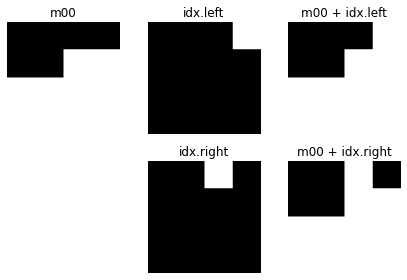

    
Creating batch
    evals = 42
    q: ind = 301046 (-> 150518)
       m00 = [ True  True  True ... False False False]
       f00 = [5.96379399e-01 2.08263978e-01 1.91589698e-01 2.53855274e-03
 3.24154156e-04]
       f11 = [6.51186824e-01 2.31243774e-01 1.12901889e-01 3.41449887e-03
 2.84374080e-04]
       weight = 0.125
       cluster row = [301037. 301036.      0.  18816.]
    Is leaf? = False


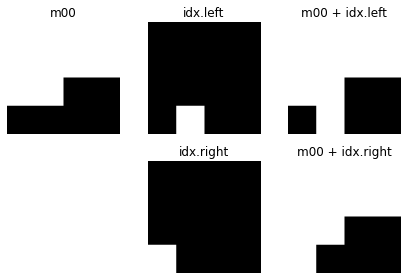

    
Creating batch
    evals = 42
    q: ind = 301044 (-> 150516)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [7.76854098e-01 1.47549063e-01 6.95253685e-02 2.92383763e-03
 5.23421390e-04]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.125
       cluster row = [301033. 301032.      0.  18816.]
    Is leaf? = False


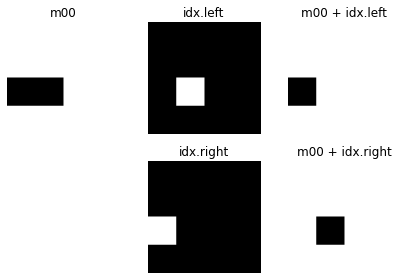

    
Creating batch
    evals = 42
    q: ind = 301044 (-> 150516)
       m00 = [ True  True  True ... False False False]
       f00 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       f11 = [5.96379399e-01 2.08263978e-01 1.91589698e-01 2.53855274e-03
 3.24154156e-04]
       weight = 0.125
       cluster row = [301033. 301032.      0.  18816.]
    Is leaf? = False


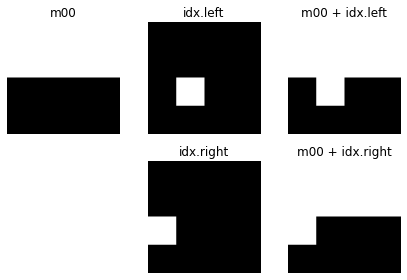

    
Creating batch
    evals = 42
    q: ind = 301046 (-> 150518)
       m00 = [ True  True  True ...  True  True  True]
       f00 = [7.61867642e-01 1.41677216e-01 9.14107338e-02 2.77574710e-03
 5.59277309e-04]
       f11 = [0.6994136  0.17954771 0.11283065 0.00400145 0.00097029]
       weight = 0.125
       cluster row = [301037. 301036.      0.  18816.]
    Is leaf? = False


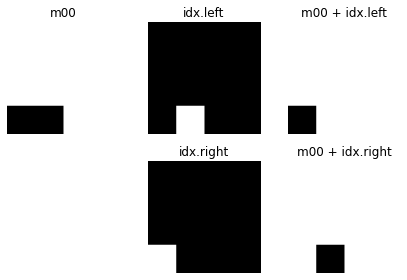

    
Creating batch
    evals = 42
    q: ind = 301045 (-> 150517)
       m00 = [ True  True  True ... False False False]
       f00 = [6.49072349e-01 2.18862385e-01 1.25716388e-01 4.87680826e-03
 1.99062109e-04]
       f11 = [7.08501518e-01 2.07187027e-01 7.44144619e-02 5.98882884e-03
 4.97466477e-04]
       weight = 0.125
       cluster row = [301035. 301034.      0.  18816.]
    Is leaf? = False


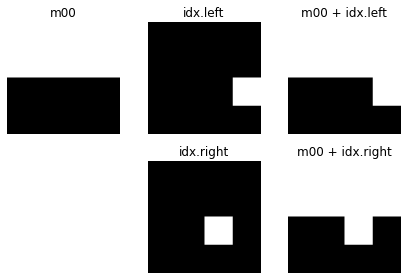

    Created batch of 50 masks

    >> Enter _masked_model.py: __call__
      >> Enter _masked_model.py: __full_masking_call
      Input masks shape: (50, 150528)

      [ Mask i = 0 ]
      ---------------
      Mask: [ True  True  True ... False False False]
      Delta mask (mask OR last_mask): [ True  True  True ... False False False]

        >> Enter masker/_image.py: __call__
        Before  blur: [117. 119. 116. ... 189. 196. 204.]
        Applied blur  (10, 10)  on image of shape (224, 224, 3).
        After   blur: [109.63 112.2  110.02 ... 187.07 193.95 201.79]
        Replace masked values with blurred values
        Mask: [ True  True  True ... False False False]
        Output image: [117.   119.   116.   ... 187.07 193.95 201.79]
        << Exit masker/_image.py: __call__

      Number of masked inputs = 1
      (Update) num_mask_samples = [1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0]
      (Update) num_varying_rows

      Sending all to model for set of predictions:   outputs = model(joined_masked_inputs)
          (50 masks,  1000 classes ====> outputs.shape = (50, 1000))
      Returning (50, 1000) averaged output
      << Exit _masked_model.py: __full_masking_call


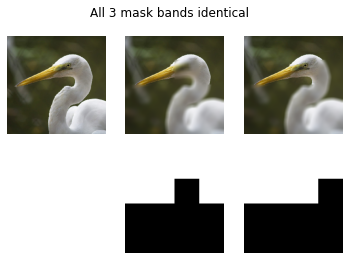

    << Exit _masked_model.py: __call__

    Ran the batch -> evaluated model on each masked input
    Using results of batch to add new nodes:
      i = 0
      weight = 0.125,  new weight = 0.0625


      i = 1
      weight = 0.125,  new weight = 0.0625


      i = 2
      weight = 0.125,  new weight = 0.0625


      i = 3
      weight = 0.125,  new weight = 0.0625


      i = 4
      weight = 0.125,  new weight = 0.0625


      i = 5
      weight = 0.125,  new weight = 0.0625


      i = 6
      weight = 0.125,  new weight = 0.0625


      i = 7
      weight = 0.125,  new weight = 0.0625


      i = 8
      weight = 0.125,  new weight = 0.0625


      i = 9
      weight = 0.125,  new weight = 0.0625


      i = 10
      weight = 0.125,  new weight = 0.0625


      i = 11
      weight = 0.125,  new weight = 0.0625


      i = 12
      weight = 0.125,  new weight = 0.0625


      i = 13
      weight = 0.125,  new weight = 0.0625


      i = 14
      weight = 0.125,  new weight = 0.0625

  9.97488073e-09]
      i = 198903, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 249078, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 198902, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 274460, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 248855, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 198679, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 248854, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 198678, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  6.64992049e-09]
      i = 274455, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 248844, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 198668, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 248843, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 198667, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 298973, value = [0. 0. 0. 0. 0.] + [ 1.21283046e-04 -8.87579251e-05 -3.30357596e-05 -1.81232284e-06
  2.79296660e-07]
      i = 295837, value = [0. 0. 0. 0. 0.] + [ 5.19784481e-05 -3.80391107e-05 -1.41581827e-05 -7.76709789e-07
  1.19698569e-07]
      i = 290557, value = [0. 0. 0. 0. 0.] + [ 2.59892241e-05 -1.90195554e-05 -7.07909

  5.98492844e-08]
      i = 274044, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 248170, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 197994, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 247946, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 197770, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 285206, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 274134, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 248169, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984

  1.59598092e-07]
      i = 292671, value = [0. 0. 0. 0. 0.] + [ 3.46522987e-05 -2.53594072e-05 -9.43878847e-06 -5.17806526e-07
  7.97990458e-08]
      i = 284734, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 272830, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 245500, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 195324, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 245499, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 195323, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 272702, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  9.97488073e-09]
      i = 194868, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 272475, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 244821, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 194645, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 244820, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 194644, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 284634, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 272602, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  6.64992049e-09]
      i = 245706, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 195530, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 284822, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 273046, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 245929, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 195753, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 245928, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 195752, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  1.99497615e-08]
      i = 250848, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 200672, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 250847, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 200671, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 285682, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 275346, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 250624, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 200448, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  6.64992049e-09]
      i = 274447, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 248825, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 198649, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 248824, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 198648, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 290644, value = [0. 0. 0. 0. 0.] + [ 2.59892241e-05 -1.90195554e-05 -7.07909135e-06 -3.88354894e-07
  5.98492844e-08]
      i = 274670, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 249271, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984

  9.97488073e-09]
      i = 199765, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 285581, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 275117, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 250164, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 199988, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 250163, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 199987, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 274989, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

      i = 273994, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 247917, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 197741, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 247916, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 197740, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 296920, value = [0. 0. 0. 0. 0.] + [ 6.93045975e-05 -5.07188143e-05 -1.88775769e-05 -1.03561305e-06
  1.59598092e-07]
      i = 292792, value = [0. 0. 0. 0. 0.] + [ 3.46522987e-05 -2.53594072e-05 -9.43878847e-06 -5.17806526e-07
  7.97990458e-08]
      i = 285289, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.5890326

  9.97488073e-09]
      i = 196861, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 273457, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 246814, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 196638, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 246813, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 196637, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 292699, value = [0. 0. 0. 0. 0.] + [ 3.46522987e-05 -2.53594072e-05 -9.43878847e-06 -5.17806526e-07
  7.97990458e-08]
      i = 284914, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939

  9.97488073e-09]
      i = 194840, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 272463, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 244793, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 194617, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 244792, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 194616, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 284622, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 272590, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  1.99497615e-08]
      i = 246352, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 196176, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 246351, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 196175, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 299960, value = [0. 0. 0. 0. 0.] + [ 2.12245330e-04 -1.55326369e-04 -5.78125794e-05 -3.17156497e-06
  4.88769156e-07]
      i = 297912, value = [0. 0. 0. 0. 0.] + [ 9.09622842e-05 -6.65684438e-05 -2.47768197e-05 -1.35924213e-06
  2.09472495e-07]
      i = 293816, value = [0. 0. 0. 0. 0.] + [ 3.89838361e-05 -2.85293331e-05 -1.06186370e-05 -5.82532341e-07
  8.97739266e-08]
      i = 276408, value = [0. 0. 0. 0. 0.] + [ 1.29946120e-05 -9.50977769e-06 -3.53954

  6.64992049e-09]
      i = 272159, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 244158, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193982, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 244157, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193981, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 295679, value = [0. 0. 0. 0. 0.] + [ 5.19784481e-05 -3.80391107e-05 -1.41581827e-05 -7.76709789e-07
  1.19698569e-07]
      i = 290175, value = [0. 0. 0. 0. 0.] + [ 2.59892241e-05 -1.90195554e-05 -7.07909135e-06 -3.88354894e-07
  5.98492844e-08]
      i = 272382, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  9.97488073e-09]
      i = 194196, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 272155, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 244149, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193973, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 244148, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193972, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 290172, value = [0. 0. 0. 0. 0.] + [ 2.59892241e-05 -1.90195554e-05 -7.07909135e-06 -3.88354894e-07
  5.98492844e-08]
      i = 272378, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  6.64992049e-09]
      i = 243697, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193521, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 284441, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 272057, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 243920, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193744, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 243919, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193743, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  9.97488073e-09]
      i = 193289, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 243464, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193288, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 271702, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 243241, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193065, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 243240, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193064, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  1.99497615e-08]
      i = 240348, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 190172, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 240347, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 190171, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 270174, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 240124, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189948, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 240123, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984

  3.98995229e-08]
      i = 270298, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 240339, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 190163, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 240338, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 190162, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 270170, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 240115, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189939, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  9.97488073e-09]
      i = 190826, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 283958, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 270742, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 241225, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 191049, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 241224, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 191048, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 270614, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  9.97488073e-09]
      i = 189487, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 269849, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 239440, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189264, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 239439, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189263, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 295485, value = [0. 0. 0. 0. 0.] + [ 5.19784481e-05 -3.80391107e-05 -1.41581827e-05 -7.76709789e-07
  1.19698569e-07]
      i = 289691, value = [0. 0. 0. 0. 0.] + [ 2.59892241e-05 -1.90195554e-05 -7.07909

  9.97488073e-09]
      i = 193947, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 244122, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193946, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 295674, value = [0. 0. 0. 0. 0.] + [ 5.19784481e-05 -3.80391107e-05 -1.41581827e-05 -7.76709789e-07
  1.19698569e-07]
      i = 290165, value = [0. 0. 0. 0. 0.] + [ 2.59892241e-05 -1.90195554e-05 -7.07909135e-06 -3.88354894e-07
  5.98492844e-08]
      i = 272367, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 244569, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 194393, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  9.97488073e-09]
      i = 192608, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 242783, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 192607, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 271378, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 242560, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 192384, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 242559, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 192383, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  3.98995229e-08]
      i = 272042, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 243885, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193709, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 243884, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193708, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 271914, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 243661, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 193485, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  6.64992049e-09]
      i = 241653, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 191477, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 284045, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 271053, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 241876, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 191700, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 241875, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 191699, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  9.97488073e-09]
      i = 189913, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 240088, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189912, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 283758, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 270286, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 240311, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 190135, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 240310, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984

  9.97488073e-09]
      i = 188799, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 283569, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 269745, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 239198, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189022, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 239197, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189021, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 269617, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  9.97488073e-09]
      i = 189237, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 283661, value = [0. 0. 0. 0. 0.] + [ 1.73261494e-05 -1.26797036e-05 -4.71939423e-06 -2.58903263e-07
  3.98995229e-08]
      i = 269965, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 239636, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189460, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 239635, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189459, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 269837, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969

  3.98995229e-08]
      i = 269961, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 239627, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189451, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 239626, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189450, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565705e-07 -4.31505438e-08
  6.64992049e-09]
      i = 269833, value = [0. 0. 0. 0. 0.] + [ 8.66307468e-06 -6.33985179e-06 -2.35969712e-06 -1.29451631e-07
  1.99497615e-08]
      i = 239403, value = [0. 0. 0. 0. 0.] + [ 4.33153734e-06 -3.16992590e-06 -1.17984856e-06 -6.47258157e-08
  9.97488073e-09]
      i = 189227, value = [0. 0. 0. 0. 0.] + [ 2.88769156e-06 -2.11328393e-06 -7.86565

  5.64767086e-09]
      i = 248359, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198183, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 285287, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 274343, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 248582, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198406, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248581, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198405, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  8.47150629e-09]
      i = 197952, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 247904, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197728, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 285188, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 274116, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 248127, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197951, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248126, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  8.47150629e-09]
      i = 198393, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248345, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198169, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 285281, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 274337, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 248568, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198392, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248567, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  5.64767086e-09]
      i = 298964, value = [0. 0. 0. 0. 0.] + [ 2.03194130e-04 -1.76281941e-04 -3.17050577e-05  2.57219572e-06
  2.37202176e-07]
      i = 295828, value = [0. 0. 0. 0. 0.] + [ 8.70831985e-05 -7.55494033e-05 -1.35878819e-05  1.10236960e-06
  1.01658075e-07]
      i = 290548, value = [0. 0. 0. 0. 0.] + [ 4.35415993e-05 -3.77747016e-05 -6.79394093e-06  5.51184798e-07
  5.08290377e-08]
      i = 274260, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 248562, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198386, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248338, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198162, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

      i = 284710, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 272806, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 245444, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 195268, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 245443, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 195267, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 272678, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 245220, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.1864133

  8.47150629e-09]
      i = 195036, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 284706, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 272802, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 245435, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 195259, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 245434, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 195258, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 272674, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464

  5.64767086e-09]
      i = 272447, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 244756, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194580, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 244755, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194579, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 299924, value = [0. 0. 0. 0. 0.] + [ 3.55589727e-04 -3.08493397e-04 -5.54838509e-05  4.50134252e-06
  4.15103808e-07]
      i = 297876, value = [0. 0. 0. 0. 0.] + [ 1.52395597e-04 -1.32211456e-04 -2.37787932e-05  1.92914679e-06
  1.77901632e-07]
      i = 293780, value = [0. 0. 0. 0. 0.] + [ 6.53123989e-05 -5.66620524e-05 -1.01909

  5.64767086e-09]
      i = 244974, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194798, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 272445, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 244751, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194575, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 244750, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194574, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 284604, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929

  1.69430126e-08]
      i = 248995, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198819, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248994, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198818, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 274424, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 248771, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 198595, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248770, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  5.64767086e-09]
      i = 292754, value = [0. 0. 0. 0. 0.] + [ 5.80554657e-05 -5.03662688e-05 -9.05858790e-06  7.34913064e-07
  6.77720503e-08]
      i = 285175, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 274103, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 248097, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197921, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 248096, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197920, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 273975, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464

  1.77901632e-07]
      i = 293840, value = [0. 0. 0. 0. 0.] + [ 6.53123989e-05 -5.66620524e-05 -1.01909114e-05  8.26777197e-07
  7.62435566e-08]
      i = 276432, value = [0. 0. 0. 0. 0.] + [ 2.17707996e-05 -1.88873508e-05 -3.39697046e-06  2.75592399e-07
  2.54145189e-08]
      i = 249206, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 199030, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 274642, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 249205, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 199029, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 249204, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  1.69430126e-08]
      i = 247857, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197681, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 247856, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197680, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 300916, value = [0. 0. 0. 0. 0.] + [ 2.84471782e-03 -2.46794717e-03 -4.43870807e-04  3.60107401e-05
  3.32083046e-06]
      i = 300777, value = [0. 0. 0. 0. 0.] + [ 1.42235891e-03 -1.23397359e-03 -2.21935404e-04  1.80053701e-05
  1.66041523e-06]
      i = 300505, value = [0. 0. 0. 0. 0.] + [ 7.11179455e-04 -6.16986793e-04 -1.10967702e-04  9.00268503e-06
  8.30207616e-07]
      i = 299955, value = [0. 0. 0. 0. 0.] + [ 3.55589727e-04 -3.08493397e-04 -5.54838

  5.64767086e-09]
      i = 290308, value = [0. 0. 0. 0. 0.] + [ 4.35415993e-05 -3.77747016e-05 -6.79394093e-06  5.51184798e-07
  5.08290377e-08]
      i = 273110, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 246079, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 195903, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 246078, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 195902, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 284790, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 273014, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464

  1.01658075e-07]
      i = 290467, value = [0. 0. 0. 0. 0.] + [ 4.35415993e-05 -3.77747016e-05 -6.79394093e-06  5.51184798e-07
  5.08290377e-08]
      i = 273876, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 247642, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197466, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 247641, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 197465, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 285076, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 273780, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464

  5.64767086e-09]
      i = 244724, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194548, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 296848, value = [0. 0. 0. 0. 0.] + [ 1.16110931e-04 -1.00732538e-04 -1.81171758e-05  1.46982613e-06
  1.35544101e-07]
      i = 292656, value = [0. 0. 0. 0. 0.] + [ 5.80554657e-05 -5.03662688e-05 -9.05858790e-06  7.34913064e-07
  6.77720503e-08]
      i = 284689, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 272785, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 245395, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 195219, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  8.47150629e-09]
      i = 193254, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 243429, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193253, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 271687, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 243206, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193030, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 243205, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193029, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  8.47150629e-09]
      i = 192125, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 242300, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 192124, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 271139, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 242077, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 191901, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 242076, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 191900, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  5.64767086e-09]
      i = 296821, value = [0. 0. 0. 0. 0.] + [ 1.16110931e-04 -1.00732538e-04 -1.81171758e-05  1.46982613e-06
  1.35544101e-07]
      i = 292597, value = [0. 0. 0. 0. 0.] + [ 5.80554657e-05 -5.03662688e-05 -9.05858790e-06  7.34913064e-07
  6.77720503e-08]
      i = 284416, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 272032, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 243862, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193686, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 243861, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193685, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  8.47150629e-09]
      i = 191662, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 270909, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 241615, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 191439, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 241614, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 191438, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 284028, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 271036, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464

  8.47150629e-09]
      i = 189892, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 240067, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 189891, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 283749, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 270277, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 240290, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190114, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 240289, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  8.47150629e-09]
      i = 190999, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 270593, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 240952, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190776, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 240951, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190775, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 295541, value = [0. 0. 0. 0. 0.] + [ 8.70831985e-05 -7.55494033e-05 -1.35878819e-05  1.10236960e-06
  1.01658075e-07]
      i = 289835, value = [0. 0. 0. 0. 0.] + [ 4.35415993e-05 -3.77747016e-05 -6.79394

  5.64767086e-09]
      i = 240944, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190768, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 295540, value = [0. 0. 0. 0. 0.] + [ 8.70831985e-05 -7.55494033e-05 -1.35878819e-05  1.10236960e-06
  1.01658075e-07]
      i = 289833, value = [0. 0. 0. 0. 0.] + [ 4.35415993e-05 -3.77747016e-05 -6.79394093e-06  5.51184798e-07
  5.08290377e-08]
      i = 270813, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 241391, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 191215, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 241390, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  5.64767086e-09]
      i = 244293, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194117, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 272121, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 244070, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193894, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 244069, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193893, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 298867, value = [0. 0. 0. 0. 0.] + [ 2.03194130e-04 -1.76281941e-04 -3.17050

  1.69430126e-08]
      i = 244513, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194337, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 244512, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194336, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 284503, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 272247, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 244289, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 194113, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  5.64767086e-09]
      i = 243613, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193437, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 284405, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 272021, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 243836, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193660, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 243835, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193659, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  5.64767086e-09]
      i = 244048, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193872, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 298864, value = [0. 0. 0. 0. 0.] + [ 2.03194130e-04 -1.76281941e-04 -3.17050577e-05  2.57219572e-06
  2.37202176e-07]
      i = 295632, value = [0. 0. 0. 0. 0.] + [ 8.70831985e-05 -7.55494033e-05 -1.35878819e-05  1.10236960e-06
  1.01658075e-07]
      i = 290064, value = [0. 0. 0. 0. 0.] + [ 4.35415993e-05 -3.77747016e-05 -6.79394093e-06  5.51184798e-07
  5.08290377e-08]
      i = 271952, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 243830, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 193654, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

  1.69430126e-08]
      i = 240712, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190536, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 240711, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190535, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 270362, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 240488, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190312, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 240487, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  1.69430126e-08]
      i = 240479, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190303, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 240478, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 190302, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 292434, value = [0. 0. 0. 0. 0.] + [ 5.80554657e-05 -5.03662688e-05 -9.05858790e-06  7.34913064e-07
  6.77720503e-08]
      i = 283735, value = [0. 0. 0. 0. 0.] + [ 2.90277328e-05 -2.51831344e-05 -4.52929395e-06  3.67456532e-07
  3.38860252e-08]
      i = 270263, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 240257, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  5.64767086e-09]
      i = 299824, value = [0. 0. 0. 0. 0.] + [ 3.55589727e-04 -3.08493397e-04 -5.54838509e-05  4.50134252e-06
  4.15103808e-07]
      i = 297776, value = [0. 0. 0. 0. 0.] + [ 1.52395597e-04 -1.32211456e-04 -2.37787932e-05  1.92914679e-06
  1.77901632e-07]
      i = 293680, value = [0. 0. 0. 0. 0.] + [ 6.53123989e-05 -5.66620524e-05 -1.01909114e-05  8.26777197e-07
  7.62435566e-08]
      i = 276272, value = [0. 0. 0. 0. 0.] + [ 2.17707996e-05 -1.88873508e-05 -3.39697046e-06  2.75592399e-07
  2.54145189e-08]
      i = 241366, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 191190, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 270802, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 241365, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232

  8.47150629e-09]
      i = 189404, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 239579, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 189403, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 269813, value = [0. 0. 0. 0. 0.] + [ 1.45138664e-05 -1.25915672e-05 -2.26464698e-06  1.83728266e-07
  1.69430126e-08]
      i = 239356, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 189180, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882325e-07  6.12427553e-08
  5.64767086e-09]
      i = 239355, value = [0. 0. 0. 0. 0.] + [ 7.25693321e-06 -6.29578360e-06 -1.13232349e-06  9.18641330e-08
  8.47150629e-09]
      i = 189179, value = [0. 0. 0. 0. 0.] + [ 4.83795547e-06 -4.19718907e-06 -7.54882

      i = 269212, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 238103, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 187927, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 238102, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 187926, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 269084, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 237879, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 187703, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.8672422

  1.86864721e-08]
      i = 268543, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 236766, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 186590, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 236765, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 186589, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 289311, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 268351, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 236543, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  2.80297082e-08]
      i = 188134, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 283381, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 269205, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 238087, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 187911, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 238086, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 187910, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 269077, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268

      i = 236524, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 186348, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 236523, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 186347, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 268311, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 236300, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 186124, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 236299, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.8008634

  1.86864721e-08]
      i = 282620, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 267228, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 234071, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183895, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 234070, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183894, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 267100, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 233847, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  4.48475331e-07]
      i = 292159, value = [0. 0. 0. 0. 0.] + [ 1.18918964e-05 -1.10069091e-05  9.09072854e-06 -2.24069072e-06
  2.24237665e-07]
      i = 282430, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 266686, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 232956, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 182780, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 232955, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 182779, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 266558, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268

  5.60594163e-08]
      i = 233392, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183216, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 233391, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183215, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 266777, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 233168, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 182992, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 233167, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  1.86864721e-08]
      i = 295228, value = [0. 0. 0. 0. 0.] + [ 1.78378446e-05 -1.65103637e-05  1.36360928e-05 -3.36103608e-06
  3.36356498e-07]
      i = 289049, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 266997, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 233607, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183431, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 233606, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183430, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 282517, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536

  5.60594163e-08]
      i = 236067, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185891, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 235843, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185667, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 282995, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 268211, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 236066, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185890, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560

  2.80297082e-08]
      i = 185660, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 282992, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 268208, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 236059, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185883, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 236058, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185882, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 268080, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268

  1.86864721e-08]
      i = 235825, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185649, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 282987, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 268203, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 236048, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185872, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 236047, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185871, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560

  1.12118833e-07]
      i = 268200, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 236041, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185865, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 236040, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185864, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 268072, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 235817, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 185641, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560

  2.80297082e-08]
      i = 182301, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 266321, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 232254, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 182078, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 232253, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 182077, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 299674, value = [0. 0. 0. 0. 0.] + [ 7.28378654e-05 -6.74173185e-05  5.56807123e-05 -1.37242307e-05
  1.37345570e-06]
      i = 297626, value = [0. 0. 0. 0. 0.] + [ 3.12162280e-05 -2.88931365e-05  2.38631

  1.86864721e-08]
      i = 267757, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 235156, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 184980, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 235155, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 184979, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 289145, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 267577, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 234933, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  1.86864721e-08]
      i = 233130, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 182954, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 289040, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 266984, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 233577, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183401, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 233576, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 183400, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560

  1.86864721e-08]
      i = 288894, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 266237, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 232058, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 181882, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 232057, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 181881, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 282237, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 266141, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268

  2.24237665e-07]
      i = 281851, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 265147, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 229813, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 179637, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 229812, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 179636, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 265019, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 229589, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  1.68178249e-07]
      i = 265821, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 231377, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 181201, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 231153, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180977, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 282137, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 265913, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 231376, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  2.80297082e-08]
      i = 179175, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 229350, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 179174, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 264789, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 229127, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178951, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 229126, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178950, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560

  2.80297082e-08]
      i = 177404, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 227579, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 177403, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 281469, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 264157, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 227802, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 177626, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 227801, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  2.80297082e-08]
      i = 178285, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 288570, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 264695, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 228908, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178732, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 228907, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178731, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 281655, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536

  5.60594163e-08]
      i = 228455, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178279, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 228454, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178278, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 288568, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 264692, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 228901, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178725, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560

      i = 181186, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 231361, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 181185, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 265779, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 231138, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180962, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 231137, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180961, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.8672422

  2.80297082e-08]
      i = 181180, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 231132, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180956, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 282128, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 265904, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 231355, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 181179, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 231354, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  1.12118833e-07]
      i = 265676, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 230898, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180722, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 230897, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180721, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 265548, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 230674, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180498, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560

  2.80297082e-08]
      i = 180941, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 231116, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180940, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 288760, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804640e-06 -1.68051804e-06
  1.68178249e-07]
      i = 265592, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 230894, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 180718, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 230670, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

      i = 264242, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 228000, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 177824, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 227999, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 177823, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 281553, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 264369, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 228222, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.8008634

  2.24237665e-07]
      i = 281551, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 264367, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 228217, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178041, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 228216, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178040, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 264239, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 227993, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  8.40891245e-08]
      i = 228878, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178702, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 264682, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 228877, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178701, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 228876, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 178700, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 288504, value = [0. 0. 0. 0. 0.] + [ 8.91892230e-06 -8.25518185e-06  6.81804

  1.86864721e-08]
      i = 264009, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 227531, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 177355, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 227530, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634107e-06 -2.80086340e-07
  2.80297082e-08]
      i = 177354, value = [0. 0. 0. 0. 0.] + [ 9.90991367e-07 -9.17242428e-07  7.57560712e-07 -1.86724227e-07
  1.86864721e-08]
      i = 281448, value = [0. 0. 0. 0. 0.] + [ 5.94594820e-06 -5.50345457e-06  4.54536427e-06 -1.12034536e-06
  1.12118833e-07]
      i = 264136, value = [0. 0. 0. 0. 0.] + [ 2.97297410e-06 -2.75172728e-06  2.27268213e-06 -5.60172680e-07
  5.60594163e-08]
      i = 227753, value = [0. 0. 0. 0. 0.] + [ 1.48648705e-06 -1.37586364e-06  1.13634

  1.18117025e-07]
      i = 269283, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 238269, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 188093, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 238268, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 188092, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 283363, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 269187, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 238045, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  1.96861708e-08]
      i = 186533, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 289303, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 268343, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 236487, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 186311, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 236263, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 186087, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 283079, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402

  1.96861708e-08]
      i = 187628, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 298740, value = [0. 0. 0. 0. 0.] + [ 1.46491154e-04 -1.59844793e-05 -1.02482042e-04  8.65958912e-07
  5.51212783e-07]
      i = 295380, value = [0. 0. 0. 0. 0.] + [ 6.27819230e-05 -6.85049114e-06 -4.39208754e-05  3.71125248e-07
  2.36234050e-07]
      i = 289428, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 268884, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 237586, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 187410, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 237362, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  1.96861708e-08]
      i = 186291, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 268287, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 236244, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 186068, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 236243, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 186067, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 298709, value = [0. 0. 0. 0. 0.] + [ 1.46491154e-04 -1.59844793e-05 -1.02482042e-04  8.65958912e-07
  5.51212783e-07]
      i = 295317, value = [0. 0. 0. 0. 0.] + [ 6.27819230e-05 -6.85049114e-06 -4.39208

  1.96861708e-08]
      i = 184058, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 292182, value = [0. 0. 0. 0. 0.] + [ 4.18546153e-05 -4.56699410e-06 -2.92805836e-05  2.47416832e-07
  1.57489367e-07]
      i = 282595, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 267203, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 234013, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 183837, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 234012, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 183836, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  3.93723416e-08]
      i = 232676, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182500, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 232675, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182499, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 282405, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 266661, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 232898, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182722, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.96861708e-08]
      i = 182936, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 233111, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182935, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 295221, value = [0. 0. 0. 0. 0.] + [ 6.27819230e-05 -6.85049114e-06 -4.39208754e-05  3.71125248e-07
  2.36234050e-07]
      i = 289035, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 266976, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 233558, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 183382, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.96861708e-08]
      i = 182929, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 233104, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182928, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 295220, value = [0. 0. 0. 0. 0.] + [ 6.27819230e-05 -6.85049114e-06 -4.39208754e-05  3.71125248e-07
  2.36234050e-07]
      i = 289033, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 266973, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 233551, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 183375, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.31241139e-08]
      i = 235785, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185609, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 289235, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 267891, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 235563, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185387, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 235339, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185163, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.31241139e-08]
      i = 236002, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185826, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 268056, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 235779, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185603, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 235778, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185602, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 289234, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604

  1.31241139e-08]
      i = 235993, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185817, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 268052, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 235770, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185594, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 235769, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185593, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 282963, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402

  1.57489367e-07]
      i = 282961, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 268177, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 235987, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185811, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 235986, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 185810, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 268049, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 235763, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  1.96861708e-08]
      i = 182022, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 232197, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182021, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 299666, value = [0. 0. 0. 0. 0.] + [ 2.56359519e-04 -2.79728388e-05 -1.79343574e-04  1.51542810e-06
  9.64622370e-07]
      i = 297618, value = [0. 0. 0. 0. 0.] + [ 1.09868365e-04 -1.19883595e-05 -7.68615319e-05  6.49469184e-07
  4.13409587e-07]
      i = 293522, value = [0. 0. 0. 0. 0.] + [ 4.70864423e-05 -5.13786836e-06 -3.29406565e-05  2.78343936e-07
  1.77175537e-07]
      i = 276114, value = [0. 0. 0. 0. 0.] + [ 1.56954808e-05 -1.71262279e-06 -1.09802188e-05  9.27813120e-08
  5.90585125e-08]
      i = 233540, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  3.93723416e-08]
      i = 232415, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182239, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 232414, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182238, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 266294, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 232191, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182015, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 232190, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  1.31241139e-08]
      i = 266738, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 233077, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182901, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 233076, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182900, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 295216, value = [0. 0. 0. 0. 0.] + [ 6.27819230e-05 -6.85049114e-06 -4.39208754e-05  3.71125248e-07
  2.36234050e-07]
      i = 289025, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 266961, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014

  1.31241139e-08]
      i = 266289, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 232179, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182003, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 232178, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 182002, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 282288, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 266416, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 232401, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  3.93723416e-08]
      i = 230427, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 180251, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 230426, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 180250, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 281922, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 265346, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 230203, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 180027, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

      i = 288874, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 266207, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 231988, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181812, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 231987, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181811, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 282207, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 266111, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.1854208

  1.96861708e-08]
      i = 179120, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 264766, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 229073, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 178897, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 229072, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 178896, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 296532, value = [0. 0. 0. 0. 0.] + [ 8.37092307e-05 -9.13398819e-06 -5.85611671e-05  4.94833664e-07
  3.14978733e-07]
      i = 292020, value = [0. 0. 0. 0. 0.] + [ 4.18546153e-05 -4.56699410e-06 -2.92805

  1.96861708e-08]
      i = 177798, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 227973, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177797, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 288439, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 264055, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 227751, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177575, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 227527, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

      i = 225947, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 175771, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 225946, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 175770, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 300682, value = [0. 0. 0. 0. 0.] + [ 1.02543808e-03 -1.11891355e-04 -7.17374297e-04  6.06171238e-06
  3.85848948e-06]
      i = 300314, value = [0. 0. 0. 0. 0.] + [ 5.12719038e-04 -5.59456777e-05 -3.58687149e-04  3.03085619e-06
  1.92924474e-06]
      i = 299573, value = [0. 0. 0. 0. 0.] + [ 2.56359519e-04 -2.79728388e-05 -1.79343574e-04  1.51542810e-06
  9.64622370e-07]
      i = 297525, value = [0. 0. 0. 0. 0.] + [ 1.09868365e-04 -1.19883595e-05 -7.68615319e-05  6.4946918

  1.31241139e-08]
      i = 264001, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 227512, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177336, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 227511, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177335, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 296501, value = [0. 0. 0. 0. 0.] + [ 8.37092307e-05 -9.13398819e-06 -5.85611671e-05  4.94833664e-07
  3.14978733e-07]
      i = 291957, value = [0. 0. 0. 0. 0.] + [ 4.18546153e-05 -4.56699410e-06 -2.92805836e-05  2.47416832e-07
  1.57489367e-07]
      i = 281536, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402

  1.96861708e-08]
      i = 175981, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 226156, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 175980, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 263228, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 225933, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 175757, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 225932, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 175756, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.31241139e-08]
      i = 231079, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 180903, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 282105, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 265881, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 231302, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181126, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 231301, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181125, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.31241139e-08]
      i = 231513, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181337, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 288866, value = [0. 0. 0. 0. 0.] + [ 3.13909615e-05 -3.42524557e-06 -2.19604377e-05  1.85562624e-07
  1.18117025e-07]
      i = 266195, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 231960, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181784, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 231959, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181783, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.96861708e-08]
      i = 181779, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 231954, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181778, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 282193, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 266097, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 231731, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 181555, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 231730, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  1.96861708e-08]
      i = 177322, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 227497, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177321, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 296499, value = [0. 0. 0. 0. 0.] + [ 8.37092307e-05 -9.13398819e-06 -5.85611671e-05  4.94833664e-07
  3.14978733e-07]
      i = 291955, value = [0. 0. 0. 0. 0.] + [ 4.18546153e-05 -4.56699410e-06 -2.92805836e-05  2.47416832e-07
  1.57489367e-07]
      i = 281530, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 264346, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 228168, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007

  1.96861708e-08]
      i = 178431, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 228606, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 178430, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 264438, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 228383, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 178207, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 228382, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 178206, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.31241139e-08]
      i = 227703, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177527, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 263987, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 227480, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177304, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 227479, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177303, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 299568, value = [0. 0. 0. 0. 0.] + [ 2.56359519e-04 -2.79728388e-05 -1.79343

  1.96861708e-08]
      i = 177744, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 291920, value = [0. 0. 0. 0. 0.] + [ 4.18546153e-05 -4.56699410e-06 -2.92805836e-05  2.47416832e-07
  1.57489367e-07]
      i = 281425, value = [0. 0. 0. 0. 0.] + [ 2.09273077e-05 -2.28349705e-06 -1.46402918e-05  1.23708416e-07
  7.87446833e-08]
      i = 264113, value = [0. 0. 0. 0. 0.] + [ 1.04636538e-05 -1.14174852e-06 -7.32014589e-06  6.18542080e-08
  3.93723416e-08]
      i = 227699, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177523, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004863e-06  2.06180693e-08
  1.31241139e-08]
      i = 227698, value = [0. 0. 0. 0. 0.] + [ 5.23182692e-06 -5.70874262e-07 -3.66007295e-06  3.09271040e-08
  1.96861708e-08]
      i = 177522, value = [0. 0. 0. 0. 0.] + [ 3.48788461e-06 -3.80582841e-07 -2.44004

  1.66496815e-08]
      i = 200357, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 250532, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 200356, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 275179, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 250309, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 200133, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 250308, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 200132, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445

  1.66496815e-08]
      i = 199022, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 249197, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 199021, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 290575, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 274479, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248975, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198799, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 248751, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.66496815e-08]
      i = 199672, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 290668, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 274796, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 249626, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 199450, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 249402, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 199226, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 285446, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467

  1.66496815e-08]
      i = 198779, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 274407, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248732, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198556, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 248731, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198555, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 298957, value = [0. 0. 0. 0. 0.] + [ 7.52661643e-05  4.01986778e-05 -9.97272438e-05 -2.71939704e-06
  4.66191083e-07]
      i = 295821, value = [0. 0. 0. 0. 0.] + [ 3.22569276e-05  1.72280048e-05 -4.27402

  3.32993630e-08]
      i = 246277, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 196101, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 246276, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 196100, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 284874, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 273322, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 246499, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 196323, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445

  1.66496815e-08]
      i = 195210, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 245385, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195209, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 272653, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 245162, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 194986, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 245161, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 194985, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445

  1.10997877e-08]
      i = 245599, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195423, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 295725, value = [0. 0. 0. 0. 0.] + [ 3.22569276e-05  1.72280048e-05 -4.27402473e-05 -1.16545587e-06
  1.99796178e-07]
      i = 290299, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 273096, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 246046, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195870, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 246045, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.10997877e-08]
      i = 290252, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 272940, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 245818, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195642, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 245594, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195418, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 284774, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 272998, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337

  9.98980891e-08]
      i = 274251, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248499, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198323, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 248275, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198099, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 285251, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 274307, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248498, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.66496815e-08]
      i = 198761, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 248936, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198760, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 274399, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248713, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198537, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 248712, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198536, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445

  1.33197452e-07]
      i = 285244, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 274300, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248482, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198306, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 248481, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 198305, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 274172, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248258, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  9.98980891e-08]
      i = 274024, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248030, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 197854, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 247806, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 197630, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 285146, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 274074, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 248029, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.66496815e-08]
      i = 194735, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 272418, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 244688, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 194512, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 244687, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 194511, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 284577, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 272545, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337

  1.66496815e-08]
      i = 194952, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 284670, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 272766, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 245351, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195175, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 245350, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195174, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 272638, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337

  1.66496815e-08]
      i = 195387, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 245562, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195386, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 290288, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 273080, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 246009, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 195833, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 246008, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

      i = 284495, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 272239, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 244270, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 194094, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 244269, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 194093, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 272111, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 244046, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.7121322

  1.10997877e-08]
      i = 284203, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 271467, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 242693, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 192517, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 242692, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 192516, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 271339, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 242469, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.10997877e-08]
      i = 241796, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191620, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 270891, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 241573, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191397, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 241572, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191396, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 284010, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467

  1.99796178e-07]
      i = 289900, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 271180, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 242234, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 192058, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 242010, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191834, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 284102, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 271238, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337

  6.65987261e-08]
      i = 270702, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 241132, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190956, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 241131, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190955, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 270574, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 240908, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190732, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445

  1.66496815e-08]
      i = 188709, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 238884, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 188708, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 283530, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 269706, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 239107, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 188931, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 239106, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.66496815e-08]
      i = 190272, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 240447, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190271, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 289709, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 270189, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 240225, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190049, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 240001, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.66496815e-08]
      i = 188469, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 238644, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 188468, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 269348, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 238421, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 188245, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 238420, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 188244, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445

      i = 243795, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 193619, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 243571, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 193395, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 284387, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 272003, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 243794, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 193618, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.4747548

      i = 192041, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 242216, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 192040, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 271103, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 241993, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191817, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 241992, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191816, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.4747548

      i = 243779, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 193603, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 271869, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 243556, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 193380, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 243555, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 193379, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 290025, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.8272793

  4.99490446e-08]
      i = 241331, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191155, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 270787, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 241330, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191154, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 241329, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191153, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 289771, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701

  3.32993630e-08]
      i = 239984, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 189808, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 239983, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 189807, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 283713, value = [0. 0. 0. 0. 0.] + [ 1.07523092e-05  5.74266826e-06 -1.42467491e-05 -3.88485291e-07
  6.65987261e-08]
      i = 270241, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 240206, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190030, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445

  3.32993630e-08]
      i = 241090, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190914, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 241089, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190913, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 270556, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 240866, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190690, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 240865, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.10997877e-08]
      i = 240860, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 190684, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 295528, value = [0. 0. 0. 0. 0.] + [ 3.22569276e-05  1.72280048e-05 -4.27402473e-05 -1.16545587e-06
  1.99796178e-07]
      i = 289809, value = [0. 0. 0. 0. 0.] + [ 1.61284638e-05  8.61400239e-06 -2.13701237e-05 -5.82727936e-07
  9.98980891e-08]
      i = 270777, value = [0. 0. 0. 0. 0.] + [ 5.37615459e-06  2.87133413e-06 -7.12337455e-06 -1.94242645e-07
  3.32993630e-08]
      i = 241307, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168728e-06 -9.71213227e-08
  1.66496815e-08]
      i = 191131, value = [0. 0. 0. 0. 0.] + [ 1.79205153e-06  9.57111377e-07 -2.37445818e-06 -6.47475485e-08
  1.10997877e-08]
      i = 241306, value = [0. 0. 0. 0. 0.] + [ 2.68807730e-06  1.43566706e-06 -3.56168

  1.88502168e-09]
      i = 199415, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 249367, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199191, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 285431, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 274839, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 249590, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199414, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 249589, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.25668112e-09]
      i = 275154, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 250251, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 200075, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 250250, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 200074, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 298982, value = [0. 0. 0. 0. 0.] + [ 5.97033650e-05 -1.03926603e-05 -3.24564338e-05 -1.86624163e-06
  5.27806070e-08]
      i = 295878, value = [0. 0. 0. 0. 0.] + [ 2.55871564e-05 -4.45399729e-06 -1.39099002e-05 -7.99817842e-07
  2.26202601e-08]
      i = 290694, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495

  1.25668112e-09]
      i = 285423, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 274831, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 249572, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199396, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 249571, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199395, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 274703, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 249348, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.88502168e-09]
      i = 199392, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 274702, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 249345, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199169, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 249344, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199168, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 296932, value = [0. 0. 0. 0. 0.] + [ 3.41162086e-05 -5.93866305e-06 -1.85465336e-05 -1.06642379e-06
  3.01603469e-08]
      i = 292836, value = [0. 0. 0. 0. 0.] + [ 1.70581043e-05 -2.96933153e-06 -9.27326

  1.88502168e-09]
      i = 197391, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 247566, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 197390, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 290406, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495011e-06 -3.99908921e-07
  1.13101301e-08]
      i = 273702, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 247344, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 197168, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 247120, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.88502168e-09]
      i = 196042, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 300483, value = [0. 0. 0. 0. 0.] + [ 2.08961777e-04 -3.63743112e-05 -1.13597518e-04 -6.53184571e-06
  1.84732124e-07]
      i = 299911, value = [0. 0. 0. 0. 0.] + [ 1.04480889e-04 -1.81871556e-05 -5.67987592e-05 -3.26592286e-06
  9.23660622e-08]
      i = 297863, value = [0. 0. 0. 0. 0.] + [ 4.47775237e-05 -7.79449526e-06 -2.43423254e-05 -1.39968122e-06
  3.95854552e-08]
      i = 293767, value = [0. 0. 0. 0. 0.] + [ 1.91903673e-05 -3.34049797e-06 -1.04324252e-05 -5.99863382e-07
  1.69651951e-08]
      i = 276359, value = [0. 0. 0. 0. 0.] + [ 6.39678910e-06 -1.11349932e-06 -3.47747506e-06 -1.99954461e-07
  5.65506504e-09]
      i = 246007, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195831, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  1.88502168e-09]
      i = 197153, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 247328, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 197152, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 273614, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 247105, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 196929, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 247104, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 196928, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  5.65506504e-09]
      i = 245993, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195817, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 273073, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 245992, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195816, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 245991, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195815, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 290245, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495

  1.88502168e-09]
      i = 200270, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 275142, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 250223, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 200047, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 250222, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 200046, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 298978, value = [0. 0. 0. 0. 0.] + [ 5.97033650e-05 -1.03926603e-05 -3.24564338e-05 -1.86624163e-06
  5.27806070e-08]
      i = 295874, value = [0. 0. 0. 0. 0.] + [ 2.55871564e-05 -4.45399729e-06 -1.39099

  1.88502168e-09]
      i = 198715, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 248667, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 198491, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 285323, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 274507, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 248890, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 198714, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 248889, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  3.77004336e-09]
      i = 249765, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199589, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 249764, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199588, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 290656, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495011e-06 -3.99908921e-07
  1.13101301e-08]
      i = 274784, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 249542, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 199366, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  3.77004336e-09]
      i = 248429, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 198253, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 248205, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 198029, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 285221, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 274277, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 248428, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 198252, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  3.77004336e-09]
      i = 246417, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 196241, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 246416, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 196240, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 273159, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 246193, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 196017, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 246192, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.25668112e-09]
      i = 245077, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 194901, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 292611, value = [0. 0. 0. 0. 0.] + [ 1.70581043e-05 -2.96933153e-06 -9.27326681e-06 -5.33211895e-07
  1.50801734e-08]
      i = 284554, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 272522, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 244856, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 194680, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 244855, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.88502168e-09]
      i = 195559, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 272835, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 245512, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195336, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 245511, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195335, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 298881, value = [0. 0. 0. 0. 0.] + [ 5.97033650e-05 -1.03926603e-05 -3.24564338e-05 -1.86624163e-06
  5.27806070e-08]
      i = 295681, value = [0. 0. 0. 0. 0.] + [ 2.55871564e-05 -4.45399729e-06 -1.39099

  7.54008671e-09]
      i = 272960, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 245729, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195553, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 245728, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195552, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 272832, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 245505, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 195329, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  1.88502168e-09]
      i = 191348, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241523, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191347, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 283989, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 270997, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241746, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191570, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241745, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.25668112e-09]
      i = 284082, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 271218, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 242187, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 192011, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 242186, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 192010, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 271090, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241963, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.88502168e-09]
      i = 192674, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 271534, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 242849, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 192673, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 242848, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 192672, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 289924, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495011e-06 -3.99908921e-07
  1.13101301e-08]
      i = 271396, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831

  3.77004336e-09]
      i = 241503, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191327, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241502, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191326, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 283980, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 270988, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241725, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191549, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  3.77004336e-09]
      i = 239725, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 189549, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 239724, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 189548, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 283603, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 269907, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 239501, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 189325, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  3.77004336e-09]
      i = 241064, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 190888, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241063, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 190887, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 270545, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 240840, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 190664, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 240839, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915

  1.88502168e-09]
      i = 189309, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 239484, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 189308, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 269772, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 239261, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 189085, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 239260, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 189084, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  1.88502168e-09]
      i = 194008, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 244183, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 194007, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 272074, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 243960, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 193784, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 243959, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 193783, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  1.88502168e-09]
      i = 191982, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 271078, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241935, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191759, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241934, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191758, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 292482, value = [0. 0. 0. 0. 0.] + [ 1.70581043e-05 -2.96933153e-06 -9.27326681e-06 -5.33211895e-07
  1.50801734e-08]
      i = 283975, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663

      i = 290017, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495011e-06 -3.99908921e-07
  1.13101301e-08]
      i = 271713, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 243277, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 193101, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 243053, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 192877, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 284261, value = [0. 0. 0. 0. 0.] + [ 8.52905214e-06 -1.48466576e-06 -4.63663341e-06 -2.66605947e-07
  7.54008671e-09]
      i = 271749, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.3330297

  1.69651951e-08]
      i = 276259, value = [0. 0. 0. 0. 0.] + [ 6.39678910e-06 -1.11349932e-06 -3.47747506e-06 -1.99954461e-07
  5.65506504e-09]
      i = 241275, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191099, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 270763, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241274, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191098, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241273, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191097, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  1.88502168e-09]
      i = 191092, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 270760, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241267, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191091, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241266, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191090, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 289762, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495011e-06 -3.99908921e-07
  1.13101301e-08]
      i = 270626, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831

  3.77004336e-09]
      i = 241260, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191084, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241259, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191083, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 289761, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495011e-06 -3.99908921e-07
  1.13101301e-08]
      i = 270625, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241037, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 190861, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772

  1.88502168e-09]
      i = 191078, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 270754, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831670e-06 -1.33302974e-07
  3.77004336e-09]
      i = 241253, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191077, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 241252, value = [0. 0. 0. 0. 0.] + [ 2.13226303e-06 -3.71166441e-07 -1.15915835e-06 -6.66514869e-08
  1.88502168e-09]
      i = 191076, value = [0. 0. 0. 0. 0.] + [ 1.42150869e-06 -2.47444294e-07 -7.72772234e-07 -4.44343246e-08
  1.25668112e-09]
      i = 289760, value = [0. 0. 0. 0. 0.] + [ 1.27935782e-05 -2.22699865e-06 -6.95495011e-06 -3.99908921e-07
  1.13101301e-08]
      i = 270624, value = [0. 0. 0. 0. 0.] + [ 4.26452607e-06 -7.42332882e-07 -2.31831

  1.35683323e-08]
      i = 237995, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187819, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 269038, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 237772, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187596, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237771, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187595, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 289502, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929

  8.14099941e-08]
      i = 269163, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 237989, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187813, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237988, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187812, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 269035, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 237765, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187589, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  2.03524985e-08]
      i = 187358, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237533, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187357, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 268808, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 237310, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187134, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237309, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187133, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  4.07049970e-08]
      i = 237081, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 186905, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237080, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 186904, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 268582, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 236857, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 186681, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 236856, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  2.03524985e-08]
      i = 184904, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 267724, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 235079, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 184903, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 235078, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 184902, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 289134, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 267566, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099

      i = 184004, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 282666, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 267402, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 234403, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 184227, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 234402, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 184226, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 267274, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.2386995

  4.07049970e-08]
      i = 233948, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183772, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 233947, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183771, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 267047, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 233724, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183548, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 233723, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  4.07049970e-08]
      i = 233941, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183765, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 233940, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183764, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 267044, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 233717, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183541, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 233716, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  2.03524985e-08]
      i = 187787, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237962, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187786, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 269024, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 237739, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187563, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237738, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187562, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  4.07049970e-08]
      i = 236402, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 186226, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 236401, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 186225, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 268259, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 236178, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 186002, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 236177, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  2.03524985e-08]
      i = 187545, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 237720, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 187544, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 298728, value = [0. 0. 0. 0. 0.] + [-2.25335725e-04  9.91439558e-05  1.37633874e-04 -1.29341793e-06
  5.69869959e-07]
      i = 295368, value = [0. 0. 0. 0. 0.] + [-9.65724538e-05  4.24902668e-05  5.89859461e-05 -5.54321970e-07
  2.44229982e-07]
      i = 289416, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 268872, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 237502, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  4.07049970e-08]
      i = 236160, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 185984, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 236159, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 185983, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 298697, value = [0. 0. 0. 0. 0.] + [-2.25335725e-04  9.91439558e-05  1.37633874e-04 -1.29341793e-06
  5.69869959e-07]
      i = 295305, value = [0. 0. 0. 0. 0.] + [-9.65724538e-05  4.24902668e-05  5.89859461e-05 -5.54321970e-07
  2.44229982e-07]
      i = 289257, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 268105, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099

      i = 234153, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183977, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 234152, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183976, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 282654, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 267390, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 234375, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 184199, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.0795665

  4.07049970e-08]
      i = 232592, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 182416, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 232591, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 182415, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 282369, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 266625, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 232814, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 182638, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  2.03524985e-08]
      i = 183300, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 233475, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183299, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 288969, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 266793, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 233253, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183077, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 233029, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  4.07049970e-08]
      i = 233467, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183291, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 233466, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183290, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 282457, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 266841, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 233243, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 183067, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  1.35683323e-08]
      i = 265198, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 229932, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179756, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 229931, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179755, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 288702, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 265421, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 230378, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  4.07049970e-08]
      i = 230371, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 180195, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 230370, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 180194, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 281898, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 265322, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 230147, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179971, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  2.03524985e-08]
      i = 178847, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 296525, value = [0. 0. 0. 0. 0.] + [-1.28763272e-04  5.66536890e-05  7.86479281e-05 -7.39095960e-07
  3.25639976e-07]
      i = 292013, value = [0. 0. 0. 0. 0.] + [-6.43816358e-05  2.83268445e-05  3.93239640e-05 -3.69547980e-07
  1.62819988e-07]
      i = 281800, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 265096, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 229694, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179518, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 229693, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  4.07049970e-08]
      i = 229685, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179509, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 229684, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179508, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 264964, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 229461, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179285, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 229460, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  2.03524985e-08]
      i = 175724, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 225899, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 175723, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 281133, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 263341, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 226122, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 175946, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 226121, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  2.03524985e-08]
      i = 175715, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 225890, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 175714, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 300678, value = [0. 0. 0. 0. 0.] + [-1.57735008e-03  6.94007690e-04  9.63437119e-04 -9.05392551e-06
  3.98908971e-06]
      i = 300310, value = [0. 0. 0. 0. 0.] + [-7.88675039e-04  3.47003845e-04  4.81718559e-04 -4.52696275e-06
  1.99454486e-06]
      i = 299565, value = [0. 0. 0. 0. 0.] + [-3.94337520e-04  1.73501923e-04  2.40859280e-04 -2.26348138e-06
  9.97272428e-07]
      i = 297517, value = [0. 0. 0. 0. 0.] + [-1.69001794e-04  7.43579668e-05  1.03225406e-04 -9.70063447e-07
  4.27402469e-07]
      i = 293421, value = [0. 0. 0. 0. 0.] + [-7.24293403e-05  3.18677001e-05  4.42394

  2.03524985e-08]
      i = 176825, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 227000, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 176824, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 263654, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 226777, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 176601, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 226776, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 176600, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  2.03524985e-08]
      i = 181298, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 231473, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 181297, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 295147, value = [0. 0. 0. 0. 0.] + [-9.65724538e-05  4.24902668e-05  5.89859461e-05 -5.54321970e-07
  2.44229982e-07]
      i = 288855, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 266178, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 231920, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 181744, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  2.03524985e-08]
      i = 179942, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 265182, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 229895, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179719, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 229894, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179718, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 298570, value = [0. 0. 0. 0. 0.] + [-2.25335725e-04  9.91439558e-05  1.37633874e-04 -1.29341793e-06
  5.69869959e-07]
      i = 295050, value = [0. 0. 0. 0. 0.] + [-9.65724538e-05  4.24902668e-05  5.89859

  1.35683323e-08]
      i = 231455, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 181279, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 298601, value = [0. 0. 0. 0. 0.] + [-2.25335725e-04  9.91439558e-05  1.37633874e-04 -1.29341793e-06
  5.69869959e-07]
      i = 295113, value = [0. 0. 0. 0. 0.] + [-9.65724538e-05  4.24902668e-05  5.89859461e-05 -5.54321970e-07
  2.44229982e-07]
      i = 288777, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 265801, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 231237, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 181061, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699

  1.35683323e-08]
      i = 264953, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 229435, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179259, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 229434, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 179258, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 281784, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 265080, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 229657, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  1.35683323e-08]
      i = 264193, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 227886, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 177710, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 227885, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 177709, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 291915, value = [0. 0. 0. 0. 0.] + [-6.43816358e-05  2.83268445e-05  3.93239640e-05 -3.69547980e-07
  1.62819988e-07]
      i = 281410, value = [0. 0. 0. 0. 0.] + [-3.21908179e-05  1.41634223e-05  1.96619820e-05 -1.84773990e-07
  8.14099941e-08]
      i = 264098, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099

  2.03524985e-08]
      i = 178371, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 264413, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 228324, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 178148, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 228323, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 178147, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 295017, value = [0. 0. 0. 0. 0.] + [-9.65724538e-05  4.24902668e-05  5.89859461e-05 -5.54321970e-07
  2.44229982e-07]
      i = 288531, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929

  1.35683323e-08]
      i = 264409, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 228315, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 178139, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 228314, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549550e-06 -4.61934975e-08
  2.03524985e-08]
      i = 178138, value = [0. 0. 0. 0. 0.] + [-5.36513632e-06  2.36057038e-06  3.27699700e-06 -3.07956650e-08
  1.35683323e-08]
      i = 288528, value = [0. 0. 0. 0. 0.] + [-4.82862269e-05  2.12451334e-05  2.94929730e-05 -2.77160985e-07
  1.22114991e-07]
      i = 264632, value = [0. 0. 0. 0. 0.] + [-1.60954090e-05  7.08171113e-06  9.83099101e-06 -9.23869950e-08
  4.07049970e-08]
      i = 228761, value = [0. 0. 0. 0. 0.] + [-8.04770448e-06  3.54085556e-06  4.91549

  1.14969957e-08]
      i = 296679, value = [0. 0. 0. 0. 0.] + [-2.78829046e-05 -3.90307155e-06  4.05002522e-05 -2.31707149e-06
  2.75927896e-07]
      i = 292327, value = [0. 0. 0. 0. 0.] + [-1.39414523e-05 -1.95153577e-06  2.02501261e-05 -1.15853575e-06
  1.37963948e-07]
      i = 283222, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 268918, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 237492, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 187316, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 237491, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 187315, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

      i = 187087, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 237262, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 187086, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 289382, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 268646, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 237040, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186864, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 236816, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.4481696

  1.14969957e-08]
      i = 268784, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 237254, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 187078, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 237253, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 187077, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 283215, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 268911, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 237476, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  6.89819740e-08]
      i = 268685, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 237023, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186847, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 237022, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186846, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 268557, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 236799, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186623, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

  1.72454935e-08]
      i = 184396, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 289164, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 267698, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 235019, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 184843, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 235018, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 184842, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 282738, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250

  6.89819740e-08]
      i = 266837, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 233234, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183058, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 233233, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183057, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 266709, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 233010, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 182834, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

      i = 183714, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 233666, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183490, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 282542, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 267150, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 233889, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183713, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 233888, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.4481696

  1.72454935e-08]
      i = 182598, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 232773, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 182597, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 266480, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 232550, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 182374, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 232549, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 182373, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

  3.44909870e-08]
      i = 236347, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186171, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 236123, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 185947, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 283019, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 268363, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 236346, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186170, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

  1.72454935e-08]
      i = 185940, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 283016, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 268360, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 236339, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186163, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 236338, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 186162, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 268232, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253

  1.72454935e-08]
      i = 185261, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 235213, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 185037, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 282821, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 267909, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 235436, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 185260, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 235435, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  3.44909870e-08]
      i = 235429, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 185253, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 235428, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 185252, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 267778, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 235205, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 185029, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 235204, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  8.45029182e-07]
      i = 297602, value = [0. 0. 0. 0. 0.] + [-3.65963123e-05 -5.12278141e-06  5.31565810e-05 -3.04115634e-06
  3.62155364e-07]
      i = 293506, value = [0. 0. 0. 0. 0.] + [-1.56841338e-05 -2.19547775e-06  2.27813918e-05 -1.30335272e-06
  1.55209442e-07]
      i = 276098, value = [0. 0. 0. 0. 0.] + [-5.22804461e-06 -7.31825915e-07  7.59379728e-06 -4.34450905e-07
  5.17364805e-08]
      i = 233428, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183252, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 266920, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 233427, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183251, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

  1.72454935e-08]
      i = 184813, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 267685, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 234988, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 184812, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 234987, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 184811, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 289121, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 267553, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253

  1.14969957e-08]
      i = 288992, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 266912, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 233409, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183233, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 233408, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 183232, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 282432, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 266816, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253

  1.72454935e-08]
      i = 181267, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 288846, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 266165, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 231890, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181714, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 231889, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181713, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 282165, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250

      i = 178798, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 296518, value = [0. 0. 0. 0. 0.] + [-2.78829046e-05 -3.90307155e-06  4.05002522e-05 -2.31707149e-06
  2.75927896e-07]
      i = 292006, value = [0. 0. 0. 0. 0.] + [-1.39414523e-05 -1.95153577e-06  2.02501261e-05 -1.15853575e-06
  1.37963948e-07]
      i = 281779, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 265075, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 229645, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 179469, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 229644, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.4481696

  1.14969957e-08]
      i = 281969, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 265617, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 230760, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 180584, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 230759, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 180583, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 265489, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 230536, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  1.69005836e-06]
      i = 299559, value = [0. 0. 0. 0. 0.] + [-8.53913953e-05 -1.19531566e-05  1.24032022e-04 -7.09603145e-06
  8.45029182e-07]
      i = 297511, value = [0. 0. 0. 0. 0.] + [-3.65963123e-05 -5.12278141e-06  5.31565810e-05 -3.04115634e-06
  3.62155364e-07]
      i = 293415, value = [0. 0. 0. 0. 0.] + [-1.56841338e-05 -2.19547775e-06  2.27813918e-05 -1.30335272e-06
  1.55209442e-07]
      i = 276007, value = [0. 0. 0. 0. 0.] + [-5.22804461e-06 -7.31825915e-07  7.59379728e-06 -4.34450905e-07
  5.17364805e-08]
      i = 228759, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 178583, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 264631, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 228758, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  3.44909870e-08]
      i = 227858, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177682, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227857, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177681, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 291911, value = [0. 0. 0. 0. 0.] + [-1.39414523e-05 -1.95153577e-06  2.02501261e-05 -1.15853575e-06
  1.37963948e-07]
      i = 281398, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 264086, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 227636, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  1.72454935e-08]
      i = 175884, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 263187, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 225837, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 175661, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 225836, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 175660, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 281106, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 263314, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253

  3.44909870e-08]
      i = 227396, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177220, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227395, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177219, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 299556, value = [0. 0. 0. 0. 0.] + [-8.53913953e-05 -1.19531566e-05  1.24032022e-04 -7.09603145e-06
  8.45029182e-07]
      i = 297508, value = [0. 0. 0. 0. 0.] + [-3.65963123e-05 -5.12278141e-06  5.31565810e-05 -3.04115634e-06
  3.62155364e-07]
      i = 293412, value = [0. 0. 0. 0. 0.] + [-1.56841338e-05 -2.19547775e-06  2.27813918e-05 -1.30335272e-06
  1.55209442e-07]
      i = 276004, value = [0. 0. 0. 0. 0.] + [-5.22804461e-06 -7.31825915e-07  7.59379

  1.14969957e-08]
      i = 231415, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181239, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 288838, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 266153, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 231862, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181686, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 231861, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181685, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

  1.72454935e-08]
      i = 181233, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 231408, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181232, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 288836, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 266150, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 231855, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181679, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 231854, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  1.14969957e-08]
      i = 231399, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181223, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 298593, value = [0. 0. 0. 0. 0.] + [-4.87950830e-05 -6.83037521e-06  7.08754413e-05 -4.05487512e-06
  4.82873818e-07]
      i = 295105, value = [0. 0. 0. 0. 0.] + [-2.09121784e-05 -2.92730366e-06  3.03751891e-05 -1.73780362e-06
  2.06945922e-07]
      i = 288769, value = [0. 0. 0. 0. 0.] + [-1.04560892e-05 -1.46365183e-06  1.51875946e-05 -8.68901811e-07
  1.03472961e-07]
      i = 265793, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 231181, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181005, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

  6.89819740e-08]
      i = 266049, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 231619, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181443, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 231618, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181442, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 265921, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 231395, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 181219, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751

  3.44909870e-08]
      i = 228058, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177882, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 228057, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177881, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 264171, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 227834, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177658, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227833, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  3.44909870e-08]
      i = 227603, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177427, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227602, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177426, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 263944, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 227379, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177203, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227378, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  1.14969957e-08]
      i = 263940, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 227370, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177194, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227369, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177193, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 281379, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 264067, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 227592, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

  1.72454935e-08]
      i = 177187, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227362, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177186, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 281376, value = [0. 0. 0. 0. 0.] + [-6.97072614e-06 -9.75767887e-07  1.01250630e-05 -5.79267874e-07
  6.89819740e-08]
      i = 264064, value = [0. 0. 0. 0. 0.] + [-3.48536307e-06 -4.87883943e-07  5.06253152e-06 -2.89633937e-07
  3.44909870e-08]
      i = 227585, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126576e-06 -1.44816968e-07
  1.72454935e-08]
      i = 177409, value = [0. 0. 0. 0. 0.] + [-1.16178769e-06 -1.62627981e-07  1.68751051e-06 -9.65446456e-08
  1.14969957e-08]
      i = 227584, value = [0. 0. 0. 0. 0.] + [-1.74268154e-06 -2.43941972e-07  2.53126

 -1.24875805e-06]
      i = 275966, value = [0. 0. 0. 0. 0.] + [-2.43199067e-05  1.66939781e-05  9.36770999e-06  1.39394908e-06
 -4.16252684e-07]
      i = 225784, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 175608, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 263164, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 225783, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 175607, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 225782, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 175606, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -1.38750895e-07]
      i = 174930, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 262714, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 224883, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 174707, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 224882, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 174706, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 291806, value = [0. 0. 0. 0. 0.] + [-6.48530846e-05  4.45172748e-05  2.49805600e-05  3.71719754e-06
 -1.11000716e-06]
      i = 280891, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902

 -9.25005963e-08]
      i = 225766, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 175590, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 281077, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 263061, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 225543, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 175367, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 225542, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 175366, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -1.38750895e-07]
      i = 173582, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 223757, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173581, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 288090, value = [0. 0. 0. 0. 0.] + [-4.86398135e-05  3.33879561e-05  1.87354200e-05  2.78789815e-06
 -8.32505367e-07]
      i = 262391, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 224204, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 174028, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 224203, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -1.38750895e-07]
      i = 171352, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 221304, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 171128, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 280316, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 261084, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 221527, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 171351, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 221526, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -5.55003578e-07]
      i = 260319, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 219966, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169790, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 219965, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169789, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 260191, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 219742, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169566, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

      i = 221508, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 171332, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 260948, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 221285, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 171109, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 221284, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 171108, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 300238, value = [0. 0. 0. 0. 0.] + [-7.94450287e-04  5.45336617e-04  3.06011860e-04  4.5535669

 -1.38750895e-07]
      i = 170888, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 287708, value = [0. 0. 0. 0. 0.] + [-4.86398135e-05  3.33879561e-05  1.87354200e-05  2.78789815e-06
 -8.32505367e-07]
      i = 260668, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 220842, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 170666, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 220618, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 170442, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 280214, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902

 -2.77501789e-07]
      i = 223968, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173792, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 223967, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173791, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 262162, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 223744, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173568, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 223743, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -1.38750895e-07]
      i = 173783, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 223958, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173782, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 262158, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 223735, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173559, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 223734, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173558, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -9.25005963e-08]
      i = 223507, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173331, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 261933, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 223284, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173108, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 223283, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 173107, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 287961, value = [0. 0. 0. 0. 0.] + [-4.86398135e-05  3.33879561e-05  1.87354

 -8.32505367e-07]
      i = 261752, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 223054, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 172878, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 222830, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 172654, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 280586, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 261834, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 223053, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -2.77501789e-07]
      i = 219939, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169763, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 219715, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169539, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 280019, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 260307, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 219938, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169762, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -1.38750895e-07]
      i = 170871, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 221046, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 170870, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 280206, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 260750, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 220823, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 170647, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 220822, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -1.38750895e-07]
      i = 169972, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 220147, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169971, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 287641, value = [0. 0. 0. 0. 0.] + [-4.86398135e-05  3.33879561e-05  1.87354200e-05  2.78789815e-06
 -8.32505367e-07]
      i = 260217, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 219925, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169749, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 219701, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -5.55003578e-07]
      i = 260298, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 219917, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169741, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 219916, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169740, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 260170, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 219693, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169517, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -9.25005963e-08]
      i = 216601, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166425, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 299358, value = [0. 0. 0. 0. 0.] + [-3.97225143e-04  2.72668308e-04  1.53005930e-04  2.27678349e-05
 -6.79879383e-06]
      i = 297310, value = [0. 0. 0. 0. 0.] + [-1.70239347e-04  1.16857846e-04  6.55739699e-05  9.75764354e-06
 -2.91376878e-06]
      i = 293214, value = [0. 0. 0. 0. 0.] + [-7.29597202e-05  5.00819342e-05  2.81031300e-05  4.18184723e-06
 -1.24875805e-06]
      i = 275806, value = [0. 0. 0. 0. 0.] + [-2.43199067e-05  1.66939781e-05  9.36770999e-06  1.39394908e-06
 -4.16252684e-07]
      i = 217944, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 167768, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -1.35975877e-05]
      i = 299389, value = [0. 0. 0. 0. 0.] + [-3.97225143e-04  2.72668308e-04  1.53005930e-04  2.27678349e-05
 -6.79879383e-06]
      i = 297341, value = [0. 0. 0. 0. 0.] + [-1.70239347e-04  1.16857846e-04  6.55739699e-05  9.75764354e-06
 -2.91376878e-06]
      i = 293245, value = [0. 0. 0. 0. 0.] + [-7.29597202e-05  5.00819342e-05  2.81031300e-05  4.18184723e-06
 -1.24875805e-06]
      i = 275837, value = [0. 0. 0. 0. 0.] + [-2.43199067e-05  1.66939781e-05  9.36770999e-06  1.39394908e-06
 -4.16252684e-07]
      i = 219505, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 169329, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 260089, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 219504, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -9.25005963e-08]
      i = 279637, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 259221, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 217703, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 167527, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 217702, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 167526, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 259093, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 217479, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -9.25005963e-08]
      i = 287294, value = [0. 0. 0. 0. 0.] + [-4.86398135e-05  3.33879561e-05  1.87354200e-05  2.78789815e-06
 -8.32505367e-07]
      i = 258557, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 216378, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166202, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 216377, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166201, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 279357, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 258461, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513

      i = 163734, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 287006, value = [0. 0. 0. 0. 0.] + [-4.86398135e-05  3.33879561e-05  1.87354200e-05  2.78789815e-06
 -8.32505367e-07]
      i = 257150, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 213688, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 163512, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 213464, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 163288, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 278876, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.8585987

 -9.25005963e-08]
      i = 257881, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 215024, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 164848, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 215023, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 164847, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 296253, value = [0. 0. 0. 0. 0.] + [-1.29706169e-04  8.90345496e-05  4.99611200e-05  7.43439508e-06
 -2.22001431e-06]
      i = 291453, value = [0. 0. 0. 0. 0.] + [-6.48530846e-05  4.45172748e-05  2.49805600e-05  3.71719754e-06
 -1.11000716e-06]
      i = 279256, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902

 -9.25005963e-08]
      i = 278964, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 257460, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 214117, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 163941, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 214116, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 163940, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 257332, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 213893, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -9.25005963e-08]
      i = 218369, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 168193, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 259411, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 218146, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 167970, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 218145, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 167969, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 296315, value = [0. 0. 0. 0. 0.] + [-1.29706169e-04  8.90345496e-05  4.99611

 -9.25005963e-08]
      i = 216570, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166394, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 296282, value = [0. 0. 0. 0. 0.] + [-1.29706169e-04  8.90345496e-05  4.99611200e-05  7.43439508e-06
 -2.22001431e-06]
      i = 291514, value = [0. 0. 0. 0. 0.] + [-6.48530846e-05  4.45172748e-05  2.49805600e-05  3.71719754e-06
 -1.11000716e-06]
      i = 279535, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 258991, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 217241, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 167065, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -9.25005963e-08]
      i = 218133, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 167957, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 279725, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 259533, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 218356, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 168180, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 218355, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 168179, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -1.38750895e-07]
      i = 166603, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 216778, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166602, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 258633, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 216555, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166379, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 216554, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166378, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -1.38750895e-07]
      i = 164832, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 215007, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 164831, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 279153, value = [0. 0. 0. 0. 0.] + [-3.24265423e-05  2.22586374e-05  1.24902800e-05  1.85859877e-06
 -5.55003578e-07]
      i = 258001, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 215230, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 165054, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 215229, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257

 -6.79879383e-06]
      i = 297273, value = [0. 0. 0. 0. 0.] + [-1.70239347e-04  1.16857846e-04  6.55739699e-05  9.75764354e-06
 -2.91376878e-06]
      i = 293177, value = [0. 0. 0. 0. 0.] + [-7.29597202e-05  5.00819342e-05  2.81031300e-05  4.18184723e-06
 -1.24875805e-06]
      i = 275769, value = [0. 0. 0. 0. 0.] + [-2.43199067e-05  1.66939781e-05  9.36770999e-06  1.39394908e-06
 -4.16252684e-07]
      i = 216341, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166165, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 258541, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 216340, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166164, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

 -9.25005963e-08]
      i = 216332, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 166156, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 287224, value = [0. 0. 0. 0. 0.] + [-4.86398135e-05  3.33879561e-05  1.87354200e-05  2.78789815e-06
 -8.32505367e-07]
      i = 258360, value = [0. 0. 0. 0. 0.] + [-1.62132712e-05  1.11293187e-05  6.24513999e-06  9.29299385e-07
 -2.77501789e-07]
      i = 216110, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 165934, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171333e-06  3.09766462e-07
 -9.25005963e-08]
      i = 215886, value = [0. 0. 0. 0. 0.] + [-8.10663558e-06  5.56465935e-06  3.12257000e-06  4.64649692e-07
 -1.38750895e-07]
      i = 165710, value = [0. 0. 0. 0. 0.] + [-5.40442372e-06  3.70977290e-06  2.08171

  3.04556445e-07]
      i = 262918, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 225284, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 175108, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 225283, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 175107, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 288238, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 263141, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 225730, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  2.74100801e-06]
      i = 262742, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 225056, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174880, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 224832, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174656, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280964, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 262820, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 225055, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  4.56834668e-07]
      i = 174869, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 262688, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 224822, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174646, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 224821, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174645, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280959, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 262815, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  9.13669335e-07]
      i = 224367, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174191, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 224366, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174190, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280860, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 262588, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 224589, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174413, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  4.56834668e-07]
      i = 172191, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 222366, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 172190, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 261380, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 222143, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 171967, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 222142, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 171966, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  4.56834668e-07]
      i = 170627, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 260614, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 220580, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170404, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 220579, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170403, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 287758, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 260837, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  1.82733867e-06]
      i = 261054, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 221457, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 171281, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 221456, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 171280, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 260926, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 221233, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 171057, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  9.13669335e-07]
      i = 219896, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 169720, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 219895, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 169719, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 260161, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 219672, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 169496, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 219671, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  3.04556445e-07]
      i = 224352, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174176, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280854, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 262582, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 224575, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174399, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 224574, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174398, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  4.56834668e-07]
      i = 173286, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 223461, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 173285, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 261913, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 223238, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 173062, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 223237, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 173061, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  4.56834668e-07]
      i = 174386, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 262449, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 224339, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174163, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 224338, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 174162, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280848, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 262576, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  1.82733867e-06]
      i = 261811, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 223000, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 172824, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 222999, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 172823, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 261683, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 222776, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 172600, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  9.13669335e-07]
      i = 221000, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170824, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 220999, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170823, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280186, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 260730, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 220776, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170600, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  4.56834668e-07]
      i = 170372, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280184, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 260728, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 220771, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170595, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 220770, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170594, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 260600, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  9.13669335e-07]
      i = 220540, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170364, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 220539, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170363, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 294705, value = [0. 0. 0. 0. 0.] + [-6.74984171e-04  3.20839219e-04  3.15793338e-04  1.76549109e-05
  5.48201601e-06]
      i = 287747, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 260820, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 220986, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  2.74100801e-06]
      i = 260816, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 220977, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170801, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 220976, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 170800, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 280176, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 260720, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 220753, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  4.56834668e-07]
      i = 167045, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 258855, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 216998, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166822, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 216997, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166821, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 287319, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 258679, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  4.56834668e-07]
      i = 166590, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 258628, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 216543, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166367, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 216542, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166366, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 296278, value = [0. 0. 0. 0. 0.] + [-8.99978894e-04  4.27785625e-04  4.21057784e-04  2.35398811e-05
  7.30935468e-06]
      i = 291510, value = [0. 0. 0. 0. 0.] + [-4.49989447e-04  2.13892813e-04  2.10528

  4.56834668e-07]
      i = 166805, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 279519, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 258975, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 217204, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 167028, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 217203, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 167027, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 258847, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  4.56834668e-07]
      i = 166350, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 279420, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 258748, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 216749, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166573, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 216748, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166572, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 258620, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  4.56834668e-07]
      i = 164576, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 257764, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 214751, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 164575, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 214750, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 164574, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 287062, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 257590, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  4.56834668e-07]
      i = 165688, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 215863, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 165687, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 294517, value = [0. 0. 0. 0. 0.] + [-6.74984171e-04  3.20839219e-04  3.15793338e-04  1.76549109e-05
  5.48201601e-06]
      i = 287275, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 258528, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 216310, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166134, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440

  4.56834668e-07]
      i = 164556, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 279036, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 257660, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 214509, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 164333, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 214508, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 164332, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 257532, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  4.56834668e-07]
      i = 169256, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 219431, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 169255, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 279898, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 259962, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 219208, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 169032, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 219207, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  3.04556445e-07]
      i = 287428, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 259286, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 217855, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 167679, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 217854, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 167678, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 279606, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 259190, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  4.56834668e-07]
      i = 168573, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 218525, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 168349, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 279797, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 259733, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 218748, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 168572, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 218747, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  3.04556445e-07]
      i = 258834, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 216949, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166773, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 216948, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 166772, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 287312, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 258672, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 216726, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161

  3.04556445e-07]
      i = 215177, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 165001, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 257851, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 214954, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 164778, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 214953, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 164777, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 296243, value = [0. 0. 0. 0. 0.] + [-8.99978894e-04  4.27785625e-04  4.21057

      i = 213603, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 163427, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 213602, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 163426, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 257080, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 213379, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 163203, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 213378, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.4712425

  4.56834668e-07]
      i = 165435, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 258069, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 215388, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 165212, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 215387, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 165211, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 287153, value = [0. 0. 0. 0. 0.] + [-3.37492085e-04  1.60419609e-04  1.57896669e-04  8.82745543e-06
  2.74100801e-06]
      i = 257905, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

  7.30935468e-06]
      i = 291376, value = [0. 0. 0. 0. 0.] + [-4.49989447e-04  2.13892813e-04  2.10528892e-04  1.17699406e-05
  3.65467734e-06]
      i = 278929, value = [0. 0. 0. 0. 0.] + [-2.24994724e-04  1.06946406e-04  1.05264446e-04  5.88497029e-06
  1.82733867e-06]
      i = 257425, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322230e-05  2.94248514e-06
  9.13669335e-07]
      i = 214035, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 163859, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 214034, value = [0. 0. 0. 0. 0.] + [-5.62486809e-05  2.67366016e-05  2.63161115e-05  1.47124257e-06
  4.56834668e-07]
      i = 163858, value = [0. 0. 0. 0. 0.] + [-3.74991206e-05  1.78244010e-05  1.75440743e-05  9.80828381e-07
  3.04556445e-07]
      i = 257297, value = [0. 0. 0. 0. 0.] + [-1.12497362e-04  5.34732031e-05  5.26322

      i = 212350, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162174, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 212349, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162173, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 286847, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 256383, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 212127, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 161951, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.4315680

 -6.29914333e-08]
      i = 210775, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 160599, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 210774, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 160598, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 286686, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 255614, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 210552, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 160376, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -2.09971444e-08]
      i = 212557, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162381, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 256568, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 212334, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162158, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 212333, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162157, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 278679, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068

 -6.29914333e-08]
      i = 210983, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 160807, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 210982, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 160806, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 255797, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 210759, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 160583, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 210758, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -6.29914333e-08]
      i = 208988, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158812, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 208987, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158811, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 254814, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 208764, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158588, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 208763, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -6.29914333e-08]
      i = 207413, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 157237, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 207412, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 157236, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 254043, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 207189, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 157013, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 207188, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -3.14957166e-08]
      i = 159913, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 210088, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 159912, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 286588, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 255292, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 209866, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 159690, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 209642, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -2.09971444e-08]
      i = 286966, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 257009, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 213214, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 163038, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 213213, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 163037, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 278769, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 256913, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034

 -3.14957166e-08]
      i = 162363, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 212538, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162362, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 256560, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 212315, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162139, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 212314, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162138, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -3.14957166e-08]
      i = 161683, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 296185, value = [0. 0. 0. 0. 0.] + [ 8.91902921e-06 -1.43412283e-05  1.02427337e-05  3.43576319e-06
 -5.03931466e-07]
      i = 291321, value = [0. 0. 0. 0. 0.] + [ 4.45951461e-06 -7.17061415e-06  5.12136687e-06  1.71788159e-06
 -2.51965733e-07]
      i = 278668, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 256684, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 212530, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 162354, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 212529, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -3.14957166e-08]
      i = 162120, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 291288, value = [0. 0. 0. 0. 0.] + [ 4.45951461e-06 -7.17061415e-06  5.12136687e-06  1.71788159e-06
 -2.51965733e-07]
      i = 278569, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 256457, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 212075, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 161899, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 212074, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 161898, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -1.25982867e-07]
      i = 254929, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 208958, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158782, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 208957, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158781, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 254801, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 208734, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158558, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -3.14957166e-08]
      i = 158339, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 254707, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 208514, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158338, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 208513, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 158337, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 286427, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 254523, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034

 -3.14957166e-08]
      i = 159434, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 286640, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 255464, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 210057, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 159881, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 210056, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 159880, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 278184, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068

 -3.14957166e-08]
      i = 157872, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 208047, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 157871, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 298137, value = [0. 0. 0. 0. 0.] + [ 1.56083011e-05 -2.50971495e-05  1.79247840e-05  6.01258558e-06
 -8.81880066e-07]
      i = 294169, value = [0. 0. 0. 0. 0.] + [ 6.68927191e-06 -1.07559212e-05  7.68205030e-06  2.57682239e-06
 -3.77948600e-07]
      i = 286393, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 254297, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 207829, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -6.29914333e-08]
      i = 206296, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 156120, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 206072, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 155896, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 277532, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 253628, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 206295, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 156119, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -6.29914333e-08]
      i = 204287, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 154111, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 204063, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 153887, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 277151, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 252639, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 204286, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 154110, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -6.29914333e-08]
      i = 205607, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 155431, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 205606, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 155430, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 277428, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 253396, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 205829, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 155653, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -1.25982867e-07]
      i = 252631, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 204268, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 154092, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 204267, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 154091, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 252503, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 204044, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 153868, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -9.44871499e-08]
      i = 202271, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152095, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 251647, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 202270, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152094, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 202269, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152093, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 285791, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102

 -6.29914333e-08]
      i = 202263, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152087, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 202262, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152086, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 285790, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 251454, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 202040, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151864, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -2.09971444e-08]
      i = 276760, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 251544, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 202030, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151854, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 202029, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151853, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 251416, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 201806, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

      i = 251540, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 202021, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151845, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 202020, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151844, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 251412, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 201797, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151621, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.4315680

 -3.14957166e-08]
      i = 154083, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 204035, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 153859, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 277139, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 252627, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 204258, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 154082, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 204257, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -3.14957166e-08]
      i = 154296, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 277230, value = [0. 0. 0. 0. 0.] + [ 2.22975730e-06 -3.58530707e-06  2.56068343e-06  8.58940797e-07
 -1.25982867e-07]
      i = 252846, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 204695, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 154519, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 204694, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 154518, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 252718, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034

 -3.14957166e-08]
      i = 155182, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 253162, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 205357, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 155181, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 205356, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 155180, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 286104, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 252984, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034

 -1.25982867e-07]
      i = 252307, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 203586, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 153410, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 203585, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 153409, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 252179, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 203362, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 153186, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -2.09971444e-08]
      i = 251184, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 201339, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151163, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 201338, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 151162, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 285722, value = [0. 0. 0. 0. 0.] + [ 3.34463595e-06 -5.37796061e-06  3.84102515e-06  1.28841120e-06
 -1.88974300e-07]
      i = 251002, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 201116, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170

 -3.14957166e-08]
      i = 152500, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 202675, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152499, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 251725, value = [0. 0. 0. 0. 0.] + [ 1.11487865e-06 -1.79265354e-06  1.28034172e-06  4.29470399e-07
 -6.29914333e-08]
      i = 202452, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152276, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780572e-07  1.43156800e-07
 -2.09971444e-08]
      i = 202451, value = [0. 0. 0. 0. 0.] + [ 5.57439326e-07 -8.96326768e-07  6.40170859e-07  2.14735199e-07
 -3.14957166e-08]
      i = 152275, value = [0. 0. 0. 0. 0.] + [ 3.71626217e-07 -5.97551179e-07  4.26780

 -1.34328573e-06]
      i = 300998, value = [0. 0. 0. 0. 0.] + [-0.0332754   0.01971244  0.01145779  0.0017945   0.00018961]
      i = 300941, value = [0. 0. 0. 0. 0.] + [-1.66376978e-02  9.85622162e-03  5.72889522e-03  8.97250656e-04
  9.48043868e-05]
      i = 300829, value = [0. 0. 0. 0. 0.] + [-8.31884891e-03  4.92811081e-03  2.86444761e-03  4.48625328e-04
  4.74021934e-05]
      i = 300603, value = [0. 0. 0. 0. 0.] + [-4.15942445e-03  2.46405541e-03  1.43222381e-03  2.24312664e-04
  2.37010967e-05]
      i = 300155, value = [0. 0. 0. 0. 0.] + [-2.07971223e-03  1.23202770e-03  7.16111903e-04  1.12156332e-04
  1.18505484e-05]
      i = 299255, value = [0. 0. 0. 0. 0.] + [-1.03985611e-03  6.16013851e-04  3.58055951e-04  5.60781660e-05
  5.92527418e-06]
      i = 297207, value = [0. 0. 0. 0. 0.] + [-4.45652620e-04  2.64005936e-04  1.53452551e-04  2.40334997e-05
  2.53940322e-06]
      i = 293111, value = [0. 0. 0. 0. 0.] + [-1.90993980e-04  1.13145401e-04  6.57653788e-05  1.03000713e-

  5.92527418e-06]
      i = 297206, value = [0. 0. 0. 0. 0.] + [-4.45652620e-04  2.64005936e-04  1.53452551e-04  2.40334997e-05
  2.53940322e-06]
      i = 293110, value = [0. 0. 0. 0. 0.] + [-1.90993980e-04  1.13145401e-04  6.57653788e-05  1.03000713e-05
  1.08831567e-06]
      i = 275702, value = [0. 0. 0. 0. 0.] + [-6.36646600e-05  3.77151338e-05  2.19217929e-05  3.43335710e-06
  3.62771888e-07]
      i = 213184, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 163008, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 256996, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 213183, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 163007, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  8.06159752e-08]
      i = 213175, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162999, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 286901, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 256821, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 212953, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162777, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 212729, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162553, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  1.20923963e-07]
      i = 162544, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 294388, value = [0. 0. 0. 0. 0.] + [-2.54658640e-04  1.50860535e-04  8.76871717e-05  1.37334284e-05
  1.45108755e-06]
      i = 286953, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 256989, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 213167, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162991, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 213166, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162990, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  2.41847926e-07]
      i = 209604, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159428, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 209603, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159427, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 286638, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 255461, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 210050, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159874, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  1.20923963e-07]
      i = 159423, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 209598, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159422, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 294262, value = [0. 0. 0. 0. 0.] + [-2.54658640e-04  1.50860535e-04  8.76871717e-05  1.37334284e-05
  1.45108755e-06]
      i = 286637, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 255459, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 210045, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159869, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  8.06159752e-08]
      i = 298165, value = [0. 0. 0. 0. 0.] + [-5.94203493e-04  3.52007915e-04  2.04603401e-04  3.20446663e-05
  3.38587096e-06]
      i = 294229, value = [0. 0. 0. 0. 0.] + [-2.54658640e-04  1.50860535e-04  8.76871717e-05  1.37334284e-05
  1.45108755e-06]
      i = 286549, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 255061, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 209369, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159193, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 209145, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 158969, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  8.06159752e-08]
      i = 209580, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159404, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 298164, value = [0. 0. 0. 0. 0.] + [-5.94203493e-04  3.52007915e-04  2.04603401e-04  3.20446663e-05
  3.38587096e-06]
      i = 294228, value = [0. 0. 0. 0. 0.] + [-2.54658640e-04  1.50860535e-04  8.76871717e-05  1.37334284e-05
  1.45108755e-06]
      i = 286548, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 255060, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 209362, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159186, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  8.06159752e-08]
      i = 256315, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 211818, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 161642, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 211817, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 161641, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 296179, value = [0. 0. 0. 0. 0.] + [-3.39544853e-04  2.01147380e-04  1.16916229e-04  1.83112379e-05
  1.93478340e-06]
      i = 291315, value = [0. 0. 0. 0. 0.] + [-1.69772427e-04  1.00573690e-04  5.84581145e-05  9.15561894e-06
  9.67391702e-07]
      i = 278650, value = [0. 0. 0. 0. 0.] + [-8.48862133e-05  5.02868450e-05  2.92290

  2.41847926e-07]
      i = 212257, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162081, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 212256, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162080, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 278646, value = [0. 0. 0. 0. 0.] + [-8.48862133e-05  5.02868450e-05  2.92290572e-05  4.57780947e-06
  4.83695851e-07]
      i = 256662, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 212479, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 162303, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  1.20923963e-07]
      i = 161848, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 212023, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 161847, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 256307, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 211800, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 161624, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 211799, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 161623, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  8.06159752e-08]
      i = 256305, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 211795, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 161619, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 211794, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 161618, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 278544, value = [0. 0. 0. 0. 0.] + [-8.48862133e-05  5.02868450e-05  2.92290572e-05  4.57780947e-06
  4.83695851e-07]
      i = 256432, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 212017, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726

      i = 286629, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 255447, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 210017, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159841, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 210016, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 159840, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 278167, value = [0. 0. 0. 0. 0.] + [-8.48862133e-05  5.02868450e-05  2.92290572e-05  4.57780947e-06
  4.83695851e-07]
      i = 255351, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.2889047

  1.20923963e-07]
      i = 157832, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 208007, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 157831, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 286470, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 254681, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 208454, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 158278, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 208453, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726

  1.20923963e-07]
      i = 158485, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 208660, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 158484, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 296112, value = [0. 0. 0. 0. 0.] + [-3.39544853e-04  2.01147380e-04  1.16916229e-04  1.83112379e-05
  1.93478340e-06]
      i = 291184, value = [0. 0. 0. 0. 0.] + [-1.69772427e-04  1.00573690e-04  5.84581145e-05  9.15561894e-06
  9.67391702e-07]
      i = 278065, value = [0. 0. 0. 0. 0.] + [-8.48862133e-05  5.02868450e-05  2.92290572e-05  4.57780947e-06
  4.83695851e-07]
      i = 255121, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 209331, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726

  2.41847926e-07]
      i = 207770, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 157594, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 207769, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 157593, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 254228, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 207546, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 157370, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 207545, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726

  1.08831567e-06]
      i = 275543, value = [0. 0. 0. 0. 0.] + [-6.36646600e-05  3.77151338e-05  2.19217929e-05  3.43335710e-06
  3.62771888e-07]
      i = 205351, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155175, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 253159, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 205350, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155174, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 205349, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155173, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  2.41847926e-07]
      i = 204002, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 153826, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 204001, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 153825, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 299094, value = [0. 0. 0. 0. 0.] + [-1.03985611e-03  6.16013851e-04  3.58055951e-04  5.60781660e-05
  5.92527418e-06]
      i = 297046, value = [0. 0. 0. 0. 0.] + [-4.45652620e-04  2.64005936e-04  1.53452551e-04  2.40334997e-05
  2.53940322e-06]
      i = 292950, value = [0. 0. 0. 0. 0.] + [-1.90993980e-04  1.13145401e-04  6.57653788e-05  1.03000713e-05
  1.08831567e-06]
      i = 275542, value = [0. 0. 0. 0. 0.] + [-6.36646600e-05  3.77151338e-05  2.19217

  1.20923963e-07]
      i = 154711, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 294069, value = [0. 0. 0. 0. 0.] + [-2.54658640e-04  1.50860535e-04  8.76871717e-05  1.37334284e-05
  1.45108755e-06]
      i = 286155, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 253152, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 205334, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155158, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 205333, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155157, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  1.20923963e-07]
      i = 154926, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 252925, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 204879, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 154703, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 204878, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 154702, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 286152, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 253148, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145

  4.83695851e-07]
      i = 251079, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 201094, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150918, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 201093, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150917, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 250951, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 200870, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150694, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  8.06159752e-08]
      i = 200864, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150688, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 276548, value = [0. 0. 0. 0. 0.] + [-8.48862133e-05  5.02868450e-05  2.92290572e-05  4.57780947e-06
  4.83695851e-07]
      i = 251076, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 201087, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150911, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 201086, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150910, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  1.20923963e-07]
      i = 150899, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 250943, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 200852, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150676, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 200851, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150675, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 299028, value = [0. 0. 0. 0. 0.] + [-1.03985611e-03  6.16013851e-04  3.58055951e-04  5.60781660e-05
  5.92527418e-06]
      i = 296980, value = [0. 0. 0. 0. 0.] + [-4.45652620e-04  2.64005936e-04  1.53452

  1.20923963e-07]
      i = 151341, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 201516, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 151340, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 251164, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 201293, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 151117, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 201292, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 151116, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

  3.62771888e-07]
      i = 205316, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155140, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 253144, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 205315, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155139, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 205314, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 155138, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 286098, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435

  8.06159752e-08]
      i = 252470, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 203967, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 153791, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 203966, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 153790, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 300568, value = [0. 0. 0. 0. 0.] + [-4.15942445e-03  2.46405541e-03  1.43222381e-03  2.24312664e-04
  2.37010967e-05]
      i = 300088, value = [0. 0. 0. 0. 0.] + [-2.07971223e-03  1.23202770e-03  7.16111903e-04  1.12156332e-04
  1.18505484e-05]
      i = 299121, value = [0. 0. 0. 0. 0.] + [-1.03985611e-03  6.16013851e-04  3.58055

  1.20923963e-07]
      i = 154898, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 252913, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 204851, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 154675, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 204850, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 154674, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 286144, value = [0. 0. 0. 0. 0.] + [-1.27329320e-04  7.54302675e-05  4.38435859e-05  6.86671420e-06
  7.25543777e-07]
      i = 253136, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145

  4.83695851e-07]
      i = 252281, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 203526, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 153350, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 203525, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 153349, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 252153, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 203302, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 153126, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150

      i = 251064, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 201059, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150883, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 201058, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150882, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 250936, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 200835, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 150659, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.6296824

  9.67391702e-07]
      i = 276916, value = [0. 0. 0. 0. 0.] + [-8.48862133e-05  5.02868450e-05  2.92290572e-05  4.57780947e-06
  4.83695851e-07]
      i = 252052, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 203066, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 152890, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 203065, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726431e-06  1.14445237e-06
  1.20923963e-07]
      i = 152889, value = [0. 0. 0. 0. 0.] + [-1.41477022e-05  8.38114084e-06  4.87150954e-06  7.62968245e-07
  8.06159752e-08]
      i = 251924, value = [0. 0. 0. 0. 0.] + [-4.24431067e-05  2.51434225e-05  1.46145286e-05  2.28890473e-06
  2.41847926e-07]
      i = 202842, value = [0. 0. 0. 0. 0.] + [-2.12215533e-05  1.25717113e-05  7.30726

 -1.06387627e-05]
      i = 297455, value = [0. 0. 0. 0. 0.] + [-2.60149752e-04  2.28414279e-04  1.25104110e-04 -4.60808923e-05
 -4.55946972e-06]
      i = 293359, value = [0. 0. 0. 0. 0.] + [-1.11492751e-04  9.78918338e-05  5.36160471e-05 -1.97489538e-05
 -1.95405845e-06]
      i = 275951, value = [0. 0. 0. 0. 0.] + [-3.71642503e-05  3.26306113e-05  1.78720157e-05 -6.58298461e-06
 -6.51352817e-07]
      i = 225679, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175503, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 263119, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 225678, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175502, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -1.44745070e-07]
      i = 291791, value = [0. 0. 0. 0. 0.] + [-9.91046676e-05  8.70149634e-05  4.76587086e-05 -1.75546256e-05
 -1.73694085e-06]
      i = 280846, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 262574, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 224556, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 174380, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 224555, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 174379, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 262446, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146

 -1.44745070e-07]
      i = 225661, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175485, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 281032, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 263016, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 225438, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175262, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 225437, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175261, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -2.17117606e-07]
      i = 175031, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 225206, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175030, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 288216, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 263108, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 225653, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175477, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 225652, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -1.30270563e-06]
      i = 260975, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221423, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171247, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 221199, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171023, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 280271, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 261039, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221422, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -1.44745070e-07]
      i = 221192, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171016, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 280268, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 261036, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221415, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171239, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 221414, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171238, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -1.44745070e-07]
      i = 280359, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 261255, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221852, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171676, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 221851, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171675, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 261127, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221628, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -2.17117606e-07]
      i = 171669, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 221844, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171668, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 261124, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221621, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171445, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 221620, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171444, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -4.34235211e-07]
      i = 225420, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175244, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 225196, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175020, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 281024, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 263008, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 225419, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175243, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -1.30270563e-06]
      i = 262187, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 223859, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 173683, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 223635, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 173459, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 280739, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 262243, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 223858, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -1.44745070e-07]
      i = 288208, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 263096, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 225625, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175449, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 225624, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 175448, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 281016, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 263000, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146

 -1.44745070e-07]
      i = 288050, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 262331, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 224064, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 173888, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 224063, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 173887, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 280731, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 262235, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146

 -2.17117606e-07]
      i = 171879, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 222054, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 171878, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 298410, value = [0. 0. 0. 0. 0.] + [-3.46866337e-04  3.04552372e-04  1.66805480e-04 -6.14411897e-05
 -6.07929296e-06]
      i = 294730, value = [0. 0. 0. 0. 0.] + [-1.48657001e-04  1.30522445e-04  7.14880629e-05 -2.63319384e-05
 -2.60541127e-06]
      i = 287818, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 261194, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221836, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -4.34235211e-07]
      i = 220274, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 170098, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 220273, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 170097, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 260355, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 220050, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 169874, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 220049, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -1.44745070e-07]
      i = 260889, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221147, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 170971, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 221146, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 170970, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 280248, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 261016, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 221369, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -2.17117606e-07]
      i = 169409, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 279963, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 260251, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 219808, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 169632, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 219807, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 169631, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 260123, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146

 -1.44745070e-07]
      i = 279599, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 259183, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217614, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167438, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 217613, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167437, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 259055, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217390, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

      i = 217828, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167652, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 279595, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 259179, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217605, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167429, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 217604, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167428, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.4628854

 -1.30270563e-06]
      i = 259272, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217822, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167646, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 217821, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167645, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 279592, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 259176, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217598, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -1.30270563e-06]
      i = 259268, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217813, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167637, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 217812, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 167636, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 279588, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 259172, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217589, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -2.17117606e-07]
      i = 164078, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 214253, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164077, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 294447, value = [0. 0. 0. 0. 0.] + [-1.48657001e-04  1.30522445e-04  7.14880629e-05 -2.63319384e-05
 -2.60541127e-06]
      i = 287103, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 257742, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 214700, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164524, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -4.34235211e-07]
      i = 214693, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164517, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 214692, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164516, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 279019, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 257643, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 214469, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164293, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

      i = 163617, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 278921, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 257417, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 214016, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 163840, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 214015, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 163839, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 257289, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.3886564

 -2.17117606e-07]
      i = 163832, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 257286, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 213785, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 163609, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 213784, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 163608, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 286988, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 257132, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146

 -1.44745070e-07]
      i = 258818, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 216912, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166736, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 216911, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166735, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 279489, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 258945, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 217134, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -4.34235211e-07]
      i = 216903, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166727, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 216902, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166726, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 291466, value = [0. 0. 0. 0. 0.] + [-9.91046676e-05  8.70149634e-05  4.76587086e-05 -1.75546256e-05
 -1.73694085e-06]
      i = 279391, value = [0. 0. 0. 0. 0.] + [-4.95523338e-05  4.35074817e-05  2.38293543e-05 -8.77731281e-06
 -8.68470423e-07]
      i = 258719, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 216681, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -2.17117606e-07]
      i = 166272, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 216447, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166271, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 299336, value = [0. 0. 0. 0. 0.] + [-6.07016089e-04  5.32966651e-04  2.91909590e-04 -1.07522082e-04
 -1.06387627e-05]
      i = 297288, value = [0. 0. 0. 0. 0.] + [-2.60149752e-04  2.28414279e-04  1.25104110e-04 -4.60808923e-05
 -4.55946972e-06]
      i = 293192, value = [0. 0. 0. 0. 0.] + [-1.11492751e-04  9.78918338e-05  5.36160471e-05 -1.97489538e-05
 -1.95405845e-06]
      i = 275784, value = [0. 0. 0. 0. 0.] + [-3.71642503e-05  3.26306113e-05  1.78720157e-05 -6.58298461e-06
 -6.51352817e-07]
      i = 217790, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733

 -2.17117606e-07]
      i = 166067, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 258499, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 216242, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166066, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 216241, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166065, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 287211, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 258347, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146

 -2.17117606e-07]
      i = 164043, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 214218, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164042, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 294442, value = [0. 0. 0. 0. 0.] + [-1.48657001e-04  1.30522445e-04  7.14880629e-05 -2.63319384e-05
 -2.60541127e-06]
      i = 287093, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 257727, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 214665, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164489, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -4.34235211e-07]
      i = 216228, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166052, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 216227, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 166051, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 287209, value = [0. 0. 0. 0. 0.] + [-7.43285007e-05  6.52612225e-05  3.57440314e-05 -1.31659692e-05
 -1.30270563e-06]
      i = 258345, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 216005, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 165829, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155

 -1.44745070e-07]
      i = 214428, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164252, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 257498, value = [0. 0. 0. 0. 0.] + [-2.47761669e-05  2.17537408e-05  1.19146771e-05 -4.38865641e-06
 -4.34235211e-07]
      i = 214205, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164029, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 214204, value = [0. 0. 0. 0. 0.] + [-1.23880834e-05  1.08768704e-05  5.95733857e-06 -2.19432820e-06
 -2.17117606e-07]
      i = 164028, value = [0. 0. 0. 0. 0.] + [-8.25872230e-06  7.25124695e-06  3.97155905e-06 -1.46288547e-06
 -1.44745070e-07]
      i = 294440, value = [0. 0. 0. 0. 0.] + [-1.48657001e-04  1.30522445e-04  7.14880

 -7.04808413e-08]
      i = 175221, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 262871, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 225174, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174998, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 225173, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174997, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 294887, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 288207, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619

      i = 223594, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 173418, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 298438, value = [0. 0. 0. 0. 0.] + [ 4.16852334e-05  8.16684695e-05 -7.68222066e-05 -2.46191151e-05
 -1.97346356e-06]
      i = 294790, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 287974, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 261958, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 223376, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 173200, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.8616940

 -4.69872276e-08]
      i = 225155, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174979, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 298469, value = [0. 0. 0. 0. 0.] + [ 4.16852334e-05  8.16684695e-05 -7.68222066e-05 -2.46191151e-05
 -1.97346356e-06]
      i = 294853, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 288133, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 262725, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 224937, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174761, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -4.69872276e-08]
      i = 222910, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 172734, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 261645, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 222687, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 172511, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 222686, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 172510, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 280524, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746

 -4.69872276e-08]
      i = 260886, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 221140, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 170964, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 221139, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 170963, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 280245, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 261013, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 221362, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -4.69872276e-08]
      i = 287845, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 261413, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 222249, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 172073, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 222025, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 171849, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 280433, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 261457, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730

 -7.04808413e-08]
      i = 171396, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 221571, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 171395, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 291653, value = [0. 0. 0. 0. 0.] + [ 1.19100667e-05  2.33338484e-05 -2.19492019e-05 -7.03403289e-06
 -5.63846731e-07]
      i = 280240, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 261008, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 221350, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 171174, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -1.40961683e-07]
      i = 225371, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 175195, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 225147, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174971, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 281003, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 262987, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 225370, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 175194, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -7.04808413e-08]
      i = 174962, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 294882, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 288197, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 263079, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 225585, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 175409, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 225584, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 175408, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -4.69872276e-08]
      i = 262851, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 225128, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174952, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 225127, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174951, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 298465, value = [0. 0. 0. 0. 0.] + [ 4.16852334e-05  8.16684695e-05 -7.68222066e-05 -2.46191151e-05
 -1.97346356e-06]
      i = 294849, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 288129, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619

 -4.69872276e-08]
      i = 224678, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174502, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 280898, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 262754, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 224901, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174725, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 224900, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 174724, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -7.04808413e-08]
      i = 171382, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 221557, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 171381, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 291651, value = [0. 0. 0. 0. 0.] + [ 1.19100667e-05  2.33338484e-05 -2.19492019e-05 -7.03403289e-06
 -5.63846731e-07]
      i = 280234, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 261002, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 221336, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 171160, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -1.40961683e-07]
      i = 221105, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 170929, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 221104, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 170928, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 280230, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 260998, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 221327, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 171151, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -4.69872276e-08]
      i = 221988, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 171812, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 294752, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 287873, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 261537, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 222435, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 172259, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 222434, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -2.81923365e-07]
      i = 260676, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 220650, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 170474, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 220649, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 170473, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 260548, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 220426, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 170250, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -4.69872276e-08]
      i = 218890, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 168714, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 298342, value = [0. 0. 0. 0. 0.] + [ 4.16852334e-05  8.16684695e-05 -7.68222066e-05 -2.46191151e-05
 -1.97346356e-06]
      i = 294598, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 287494, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 259654, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 218672, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 168496, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -4.69872276e-08]
      i = 258807, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 216886, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166710, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 216885, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166709, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 287303, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 258663, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 216663, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -1.40961683e-07]
      i = 218655, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 168479, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 218654, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 168478, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 259565, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 218431, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 168255, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 218430, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -1.40961683e-07]
      i = 217092, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166916, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 217091, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166915, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 258799, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 216868, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166692, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 216867, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -7.04808413e-08]
      i = 164471, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 257719, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 214646, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 164470, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 214645, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 164469, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 287047, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 257575, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730

 -7.04808413e-08]
      i = 163346, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213521, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163345, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 257045, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 213298, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163122, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213297, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163121, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

 -4.22885048e-07]
      i = 257711, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 214628, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 164452, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 214627, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 164451, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 278991, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 257615, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 214404, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -7.04808413e-08]
      i = 163999, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 214174, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163998, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 287080, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 257708, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 214621, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 164445, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 214620, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -8.45770096e-07]
      i = 287331, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 258883, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 217083, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166907, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 216859, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166683, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 279467, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 258923, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730

 -1.97346356e-06]
      i = 294530, value = [0. 0. 0. 0. 0.] + [ 1.78651000e-05  3.50007727e-05 -3.29238028e-05 -1.05510493e-05
 -8.45770096e-07]
      i = 287330, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619014e-05 -5.27552467e-06
 -4.22885048e-07]
      i = 258882, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 217076, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166900, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 216852, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166676, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 279464, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746

 -4.69872276e-08]
      i = 217065, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166889, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 258788, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 216842, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166666, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 216841, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166665, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 279459, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746

 -4.69872276e-08]
      i = 217060, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166884, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 258786, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 216837, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166661, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 216836, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 166660, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 287296, value = [0. 0. 0. 0. 0.] + [ 8.93255002e-06  1.75003863e-05 -1.64619

 -1.40961683e-07]
      i = 213496, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163320, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213495, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163319, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 257034, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 213272, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163096, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213271, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -7.04808413e-08]
      i = 163537, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213712, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163536, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 278886, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 257382, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 213935, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163759, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213934, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -7.04808413e-08]
      i = 163082, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213257, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163081, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 278787, value = [0. 0. 0. 0. 0.] + [ 5.95503335e-06  1.16669242e-05 -1.09746009e-05 -3.51701644e-06
 -2.81923365e-07]
      i = 257155, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 213480, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163304, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213479, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365

 -7.04808413e-08]
      i = 163297, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213472, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163296, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 257024, value = [0. 0. 0. 0. 0.] + [ 2.97751667e-06  5.83346211e-06 -5.48730047e-06 -1.75850822e-06
 -1.40961683e-07]
      i = 213249, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163073, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910016e-06 -5.86169407e-07
 -4.69872276e-08]
      i = 213248, value = [0. 0. 0. 0. 0.] + [ 1.48875834e-06  2.91673105e-06 -2.74365024e-06 -8.79254111e-07
 -7.04808413e-08]
      i = 163072, value = [0. 0. 0. 0. 0.] + [ 9.92505558e-07  1.94448737e-06 -1.82910

  2.11901723e-08]
      i = 255979, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 211109, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160933, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 211108, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160932, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286780, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 256202, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 211555, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  2.11901723e-08]
      i = 213117, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162941, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 278728, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 256872, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 212894, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162718, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 212893, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162717, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  2.11901723e-08]
      i = 210648, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160472, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286668, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 255596, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 210426, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160250, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 210202, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160026, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  2.11901723e-08]
      i = 278158, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 255342, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209772, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159596, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 209771, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159595, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 255214, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209548, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  1.90711550e-07]
      i = 254062, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 207304, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157128, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 207080, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 156904, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277676, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 254124, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 207303, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  3.17852584e-08]
      i = 159135, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 254985, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209088, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 158912, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 209087, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 158911, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286509, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 254829, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  6.35705168e-08]
      i = 207285, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157109, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 207284, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157108, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 253988, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 207061, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 156885, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 207060, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  6.35705168e-08]
      i = 212430, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162254, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 212429, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162253, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 256513, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 212206, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162030, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 212205, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  2.86067326e-07]
      i = 275689, value = [0. 0. 0. 0. 0.] + [-2.85915555e-06  6.81336761e-06 -4.05748085e-06  8.96291307e-07
  9.53557752e-08]
      i = 213093, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162917, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 256957, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 213092, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162916, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 213091, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162915, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  6.35705168e-08]
      i = 213085, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162909, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 213084, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162908, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286888, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 256808, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 212862, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 162686, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  2.11901723e-08]
      i = 209969, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159793, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286571, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 255275, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209747, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159571, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 209523, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159347, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  3.17852584e-08]
      i = 159562, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 255200, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209515, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159339, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 209514, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159338, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 294250, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 286613, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496

  2.11901723e-08]
      i = 209507, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159331, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 294249, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 286611, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 255420, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209954, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159778, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 209953, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  3.17852584e-08]
      i = 159322, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286608, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 255416, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209945, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159769, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 209944, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159768, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 278136, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997

  2.11901723e-08]
      i = 298095, value = [0. 0. 0. 0. 0.] + [-2.66854518e-05  6.35914310e-05 -3.78698213e-05  8.36538553e-06
  8.89987235e-07]
      i = 294095, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 286223, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 253519, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 206191, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 156015, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205967, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155791, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

      i = 155782, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286190, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 253294, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205736, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155560, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205512, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155336, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277388, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.1950550

  6.35705168e-08]
      i = 206174, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155998, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 206173, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155997, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 253448, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205950, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155774, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205949, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  2.54282067e-07]
      i = 277381, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 253349, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205719, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155543, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205718, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155542, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 253221, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205495, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  3.17852584e-08]
      i = 153544, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 252364, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203719, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153543, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203718, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153542, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 285934, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 252206, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  3.17852584e-08]
      i = 151533, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 293935, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 285823, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 251598, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 202156, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151980, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 202155, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151979, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  6.35705168e-08]
      i = 203253, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153077, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203252, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153076, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 298028, value = [0. 0. 0. 0. 0.] + [-2.66854518e-05  6.35914310e-05 -3.78698213e-05  8.36538553e-06
  8.89987235e-07]
      i = 293964, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 285900, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 251980, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  2.11901723e-08]
      i = 201247, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151071, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 285709, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 250989, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 201025, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 150849, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 200801, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 150625, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  3.17852584e-08]
      i = 155529, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205704, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155528, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 253215, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205481, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155305, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205480, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155304, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  2.11901723e-08]
      i = 252449, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203918, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153742, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203917, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153741, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 299082, value = [0. 0. 0. 0. 0.] + [-4.66995407e-05  1.11285004e-04 -6.62721872e-05  1.46394247e-05
  1.55747766e-06]
      i = 297034, value = [0. 0. 0. 0. 0.] + [-2.00140889e-05  4.76935733e-05 -2.84023659e-05  6.27403915e-06
  6.67490426e-07]
      i = 292938, value = [0. 0. 0. 0. 0.] + [-8.57746666e-06  2.04401028e-05 -1.21724

  3.17852584e-08]
      i = 155076, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205251, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155075, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286089, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 252969, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205029, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 154853, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 204805, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  3.17852584e-08]
      i = 154620, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 294056, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 286129, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 253113, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205243, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155067, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205242, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155066, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  2.11901723e-08]
      i = 251362, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 201680, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151504, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 201679, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151503, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 285814, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 251585, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 202126, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  6.35705168e-08]
      i = 201675, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151499, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 201674, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151498, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 293930, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 285813, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 251583, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 202121, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  6.67490426e-07]
      i = 292873, value = [0. 0. 0. 0. 0.] + [-8.57746666e-06  2.04401028e-05 -1.21724425e-05  2.68887392e-06
  2.86067326e-07]
      i = 275465, value = [0. 0. 0. 0. 0.] + [-2.85915555e-06  6.81336761e-06 -4.05748085e-06  8.96291307e-07
  9.53557752e-08]
      i = 202117, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151941, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 251581, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 202116, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151940, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 202115, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  3.17852584e-08]
      i = 151485, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 201660, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151484, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 293928, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 285809, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 251577, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 202107, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151931, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  1.27141034e-07]
      i = 256402, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 211947, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 161771, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 211946, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 161770, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 256274, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 211723, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 161547, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  3.17852584e-08]
      i = 161326, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286726, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 256038, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 211280, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 161104, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 211056, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160880, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 278420, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997

  3.17852584e-08]
      i = 160870, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 211045, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160869, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286762, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 256175, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 211492, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 161316, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 211491, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  6.35705168e-08]
      i = 211041, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160865, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 211040, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160864, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 294308, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 286761, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 256173, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 211487, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  6.35705168e-08]
      i = 207924, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157748, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 207923, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157747, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286446, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 254645, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 208370, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 158194, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  3.17852584e-08]
      i = 158187, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 208362, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 158186, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277842, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 254546, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 208139, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157963, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 208138, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  2.11901723e-08]
      i = 296069, value = [0. 0. 0. 0. 0.] + [-1.52488296e-05  3.63379606e-05 -2.16398979e-05  4.78022030e-06
  5.08564134e-07]
      i = 291109, value = [0. 0. 0. 0. 0.] + [-7.62441481e-06  1.81689803e-05 -1.08199489e-05  2.39011015e-06
  2.54282067e-07]
      i = 277744, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 254320, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 207686, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157510, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 207685, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157509, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  2.11901723e-08]
      i = 277742, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 254318, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 207681, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157505, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 207680, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157504, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 254190, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 207457, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  3.17852584e-08]
      i = 160854, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 211029, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160853, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 298179, value = [0. 0. 0. 0. 0.] + [-2.66854518e-05  6.35914310e-05 -3.78698213e-05  8.36538553e-06
  8.89987235e-07]
      i = 294275, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299234e-05  3.58516523e-06
  3.81423101e-07]
      i = 286691, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 255811, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 210811, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  2.11901723e-08]
      i = 210802, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160626, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 255720, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 210579, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160403, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 210578, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160402, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286658, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496

  6.35705168e-08]
      i = 210124, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159948, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 210123, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159947, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 296129, value = [0. 0. 0. 0. 0.] + [-1.52488296e-05  3.63379606e-05 -2.16398979e-05  4.78022030e-06
  5.08564134e-07]
      i = 291233, value = [0. 0. 0. 0. 0.] + [-7.62441481e-06  1.81689803e-05 -1.08199489e-05  2.39011015e-06
  2.54282067e-07]
      i = 278308, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 255844, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  6.35705168e-08]
      i = 210785, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160609, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 210784, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160608, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 255712, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 210561, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 160385, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 210560, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  3.17852584e-08]
      i = 158164, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 254632, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 208339, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 158163, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 208338, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 158162, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 286402, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 254498, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  3.17852584e-08]
      i = 159277, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 278117, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 255301, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 209676, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159500, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 209675, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 159499, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 255173, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  2.11901723e-08]
      i = 208320, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 158144, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277824, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 254528, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 208097, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157921, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 208096, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 157920, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  6.35705168e-08]
      i = 206135, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155959, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205911, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155735, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277463, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 253559, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 206134, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155958, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  5.08564134e-07]
      i = 290982, value = [0. 0. 0. 0. 0.] + [-7.62441481e-06  1.81689803e-05 -1.08199489e-05  2.39011015e-06
  2.54282067e-07]
      i = 277171, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 252787, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 204557, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 154381, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 204556, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 154380, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 252659, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  1.90711550e-07]
      i = 253285, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205673, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155497, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205449, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155273, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277361, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 253329, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205672, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  2.11901723e-08]
      i = 290948, value = [0. 0. 0. 0. 0.] + [-7.62441481e-06  1.81689803e-05 -1.08199489e-05  2.39011015e-06
  2.54282067e-07]
      i = 277069, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 252557, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 204095, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153919, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 204094, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153918, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 252429, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  2.11901723e-08]
      i = 252340, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203663, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153487, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203662, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153486, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 285926, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 252198, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203440, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  6.35705168e-08]
      i = 203654, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153478, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203653, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153477, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 276976, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 252240, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203430, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153254, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  3.17852584e-08]
      i = 153244, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 252108, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203197, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153021, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203196, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153020, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 298020, value = [0. 0. 0. 0. 0.] + [-2.66854518e-05  6.35914310e-05 -3.78698213e-05  8.36538553e-06
  8.89987235e-07]
      i = 293956, value = [0. 0. 0. 0. 0.] + [-1.14366222e-05  2.72534704e-05 -1.62299

  6.35705168e-08]
      i = 205659, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155483, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205435, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155259, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277355, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 253323, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205658, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155482, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  1.27141034e-07]
      i = 253542, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 206095, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155919, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 206094, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155918, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 253414, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205871, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155695, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  3.17852584e-08]
      i = 155463, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 253187, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 205416, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155240, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 205415, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 155239, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 299104, value = [0. 0. 0. 0. 0.] + [-4.66995407e-05  1.11285004e-04 -6.62721872e-05  1.46394247e-05
  1.55747766e-06]
      i = 297056, value = [0. 0. 0. 0. 0.] + [-2.00140889e-05  4.76935733e-05 -2.84023

  3.17852584e-08]
      i = 154573, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 277253, value = [0. 0. 0. 0. 0.] + [-3.81220740e-06  9.08449015e-06 -5.40997447e-06  1.19505508e-06
  1.27141034e-07]
      i = 252997, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 204972, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 154796, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 204971, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 154795, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 252869, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498

  2.11901723e-08]
      i = 203634, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153458, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 285922, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496170e-06  1.79258261e-06
  1.90711550e-07]
      i = 252194, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203412, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153236, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203188, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153012, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662

  3.11495532e-06]
      i = 299011, value = [0. 0. 0. 0. 0.] + [-4.66995407e-05  1.11285004e-04 -6.62721872e-05  1.46394247e-05
  1.55747766e-06]
      i = 296963, value = [0. 0. 0. 0. 0.] + [-2.00140889e-05  4.76935733e-05 -2.84023659e-05  6.27403915e-06
  6.67490426e-07]
      i = 292867, value = [0. 0. 0. 0. 0.] + [-8.57746666e-06  2.04401028e-05 -1.21724425e-05  2.68887392e-06
  2.86067326e-07]
      i = 275459, value = [0. 0. 0. 0. 0.] + [-2.85915555e-06  6.81336761e-06 -4.05748085e-06  8.96291307e-07
  9.53557752e-08]
      i = 202075, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151899, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 251563, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 202074, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249

  9.53557752e-08]
      i = 203622, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153446, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 252322, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 203621, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153445, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 203620, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 153444, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 285920, value = [0. 0. 0. 0. 0.] + [-5.71831110e-06  1.36267352e-05 -8.11496

Partition explainer: 2it [01:07, 67.26s/it]               


      i = 201836, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151660, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 201835, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151659, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 251333, value = [0. 0. 0. 0. 0.] + [-1.90610370e-06  4.54224507e-06 -2.70498723e-06  5.97527538e-07
  6.35705168e-08]
      i = 201612, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.98763769e-07
  3.17852584e-08]
      i = 151436, value = [0. 0. 0. 0. 0.] + [-6.35367901e-07  1.51408169e-06 -9.01662411e-07  1.99175846e-07
  2.11901723e-08]
      i = 201611, value = [0. 0. 0. 0. 0.] + [-9.53051851e-07  2.27112254e-06 -1.35249362e-06  2.987637

In [8]:
%matplotlib inline
shap_values = explainer(np.array(X[1:2]), max_evals=100, batch_size=50, outputs=shap.Explanation.argsort.flip[:5]) 

#### Explainer options:
1. Above image masker uses a blurring technique called "inpaint_telea". There are alternate masking options available to experiment with such as "inpaint_ns" and "blur(kernel_xsize, kernel_xsize)". 
2. Recommended number of evaluations is 300-500 to get explanations with sufficient granularity for the super pixels. More the number of evaluations, more the granularity but also increases run-time. 

    Note: `outputs=shap.Explanation.argsort.flip[:4]` has been used in the code above for getting SHAP values because we want to get the top 4 most probable classes for each image i.e. top 4 classes with decreasing probability. Hence, a flip argsort sliced by 4 has been used. 

### Visualizing SHAP values output

In [9]:
# output with shap values
%matplotlib inline
shap.image_plot(shap_values)

AssertionError: Labels must have same row count as shap_values arrays!

#### Interpretation of SHAP output explanation:
1. In the first example, given bird image is classified as an American Egret with next probable classes being a Crane, Heron and Flamingo. It is the "bump" over the bird's neck that causes it to be classified as an American Egret vs a Crane, Heron or a Flamingo. You can see the neck region of the bird appropriately highlighted in red super pixels.    
2. In the second example, it is the shape of the boat which causes it to be classified as a speedboat instead of a fountain, lifeboat or snowplow (appropriately highlighted in red super pixels). 